In [1]:
import cv2
import numpy as np
from datascience import *
import matplotlib as mpl
from matplotlib import pyplot as plt
import sys
import os
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi'] = 150
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')

In [2]:
images = []
labeled_imgs = []
original_img = []
original_img1 = []
filter_img = []
image_names = []

INITIAL TEST BINARIZATION



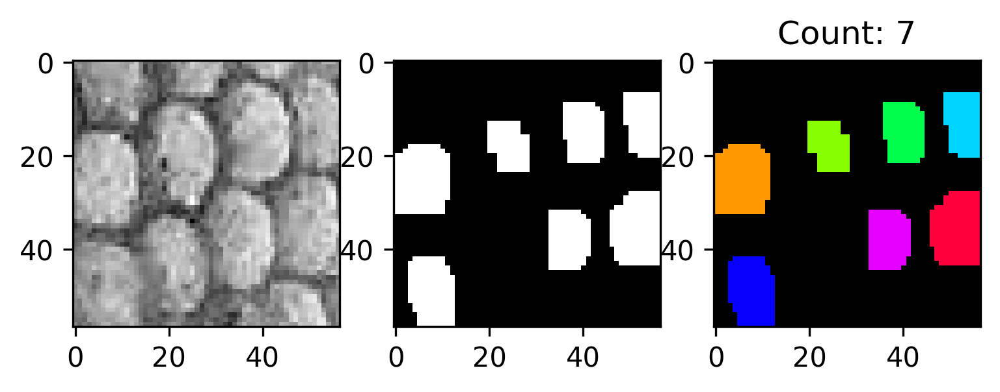

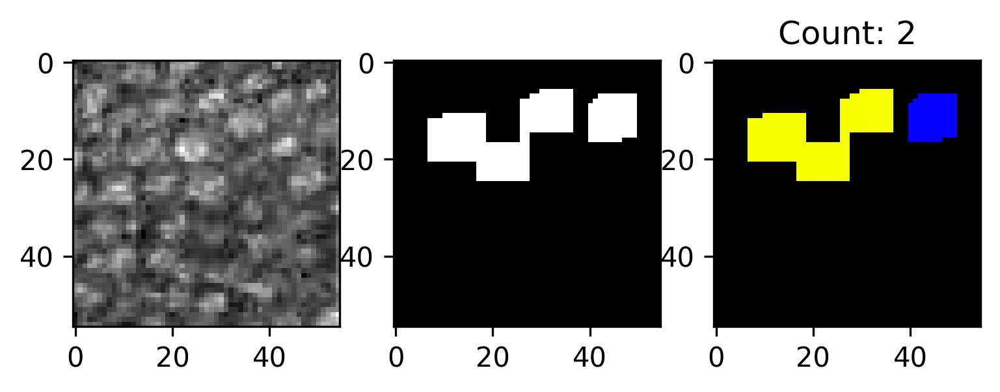

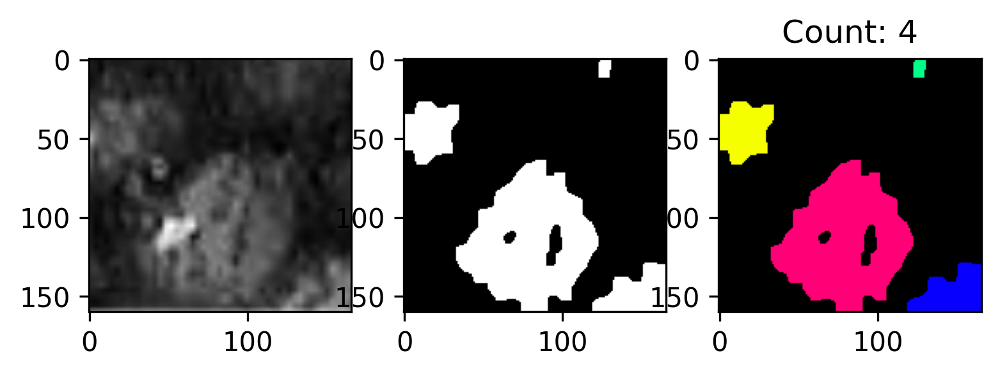

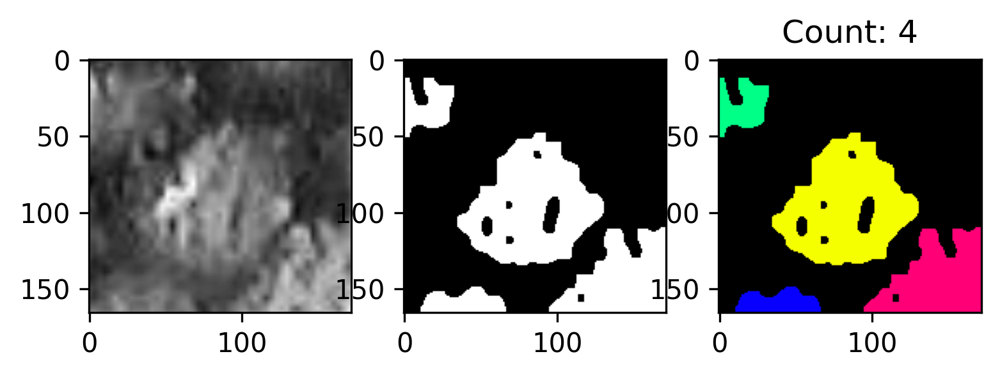

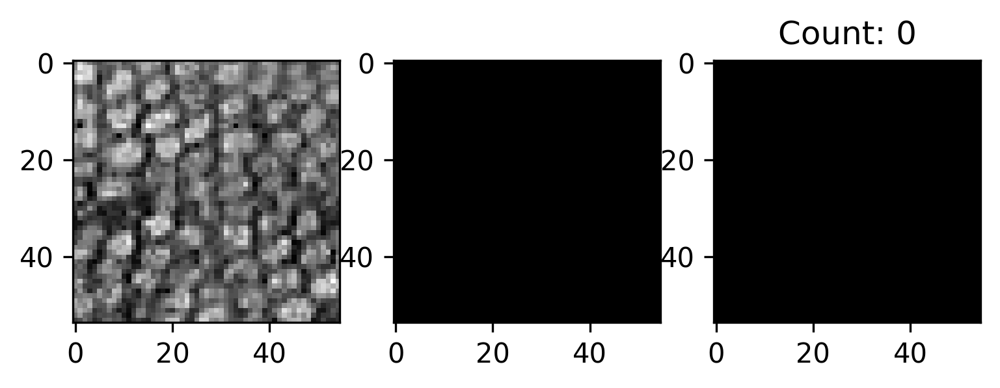

...

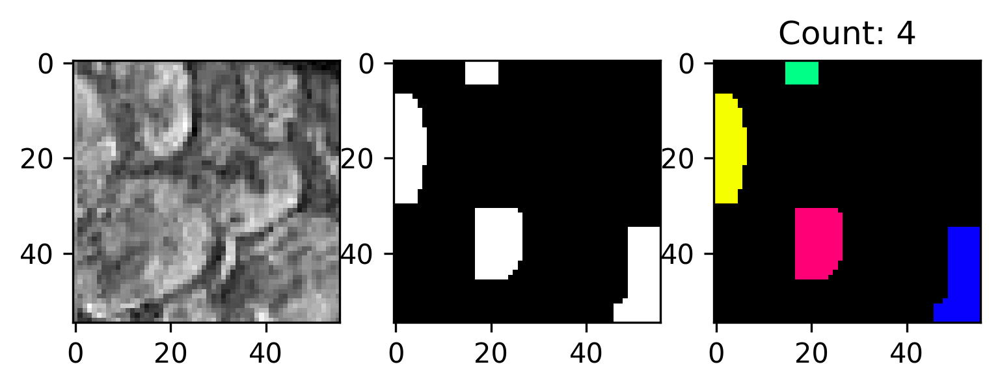

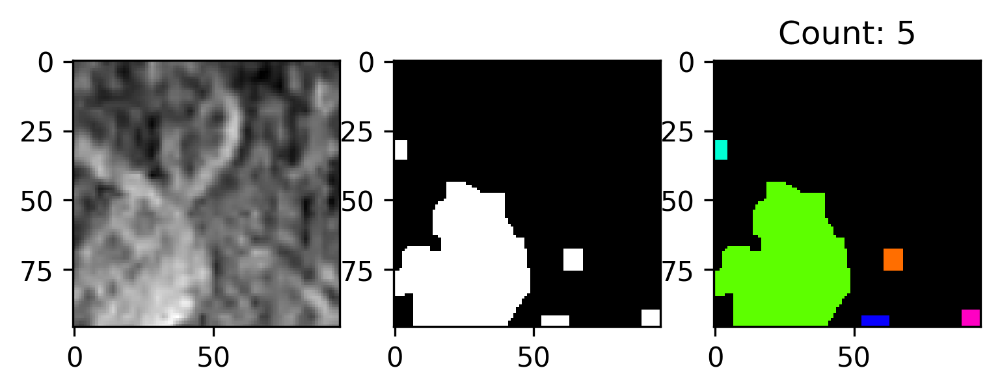

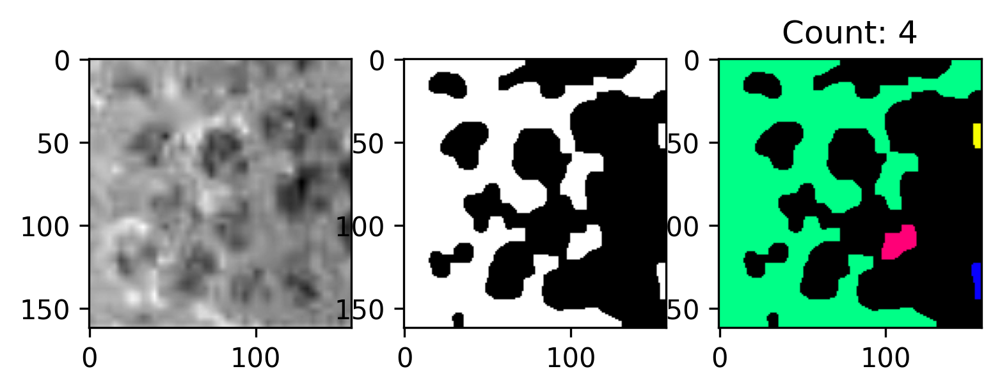

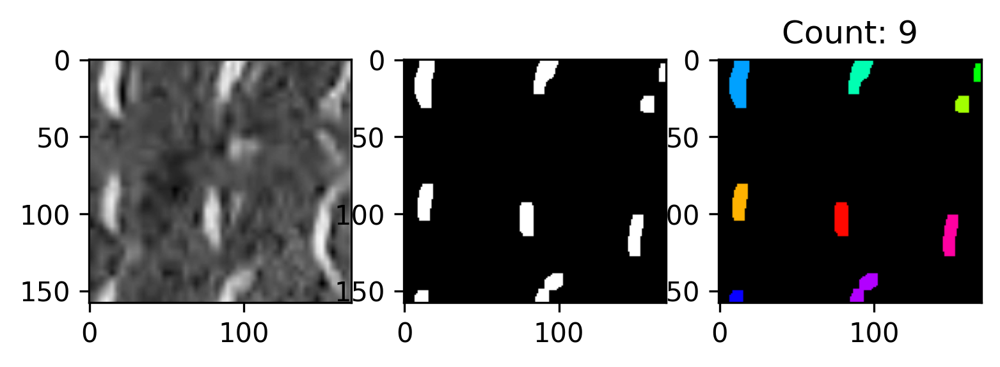

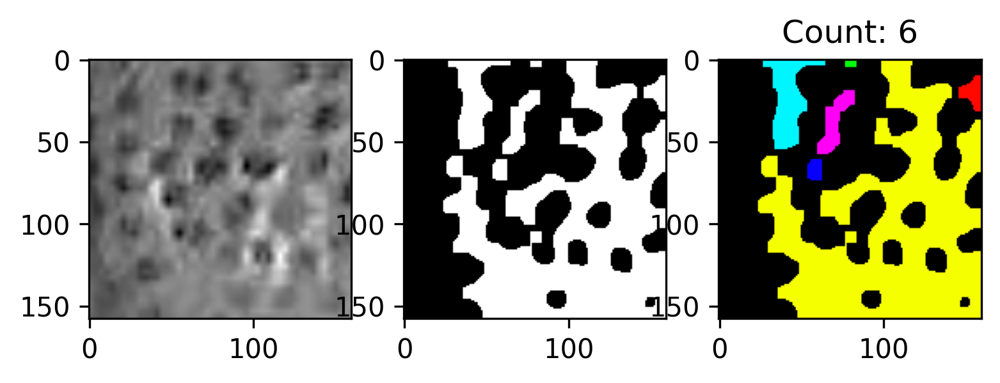

55


In [3]:
#access img directory
dirname = 'Anolis_cristatellus_images/'

#create an iterator object for img directory
directory = os.scandir(dirname)

#print(os.listdir(dirname))

def initial_binarization(initial_block_size, initial_iteration, customized):
    index = 0;
    images.clear
    
    #iterates through each image in the directory
    for img in directory:
        img_name = img.name
        if (img_name != '.ipynb_checkpoints'):
        
            if(len(customized) == 0):
                image_names.append(img.name)
            
            #read the image, convert to grayscale add to array and title + blur
            img = cv2.imread(dirname + "" + img_name)
            original_img1.append(img)
            
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            original_img.append(gray)
            title = img_name
            
            
            img = gray
#             img = img-np.min(img)
#             img = img/np.max(img)*255
#             img /= 2
#             c = 255 / np.log(1 + np.max(img)) 
#             log_image = c * (np.log(img + 1)) 
#             log_image = np.array(log_image, dtype = np.uint8)
            
            #log = np.log(gray)
            #log = log-np.min(log+1)
            #log = log/np.max(log)*255
            #log = log.astype(float)
            
            #blur = cv2.GaussianBlur(log_image,(5,5),0)
            blur = cv2.GaussianBlur(img,(5,5),0)
            blur = cv2.bilateralFilter(blur,10,10,100)
            
            filter_img.append(blur)
            #if the customized block size has not yet been determined this if statement will run
            if(len(customized)==0):
                #print("Initial Value used")
                ret, thresh = cv2.threshold(blur,120 , 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
                
            #if customized block size has been determined
            else:
                print("Customized Values used")
                print(block_size[index][0], block_size[index][1])
                thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, block_size[index][0], -2)
                
            kernel = np.ones((3,3),np.uint8)
            
            #if the customized iteration number has not yet been determined this if statement will run
            if(len(customized)==0):
                opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations = 4)
            
            #if customized array is greater than size 0 iteration number has been determined
            else:
                opening = cv2.morphologyEx(thresh,cv2.MORPH_OPEN,kernel, iterations=block_size[index][1])

            
            # sure background area
            sure_bg = cv2.dilate(opening,kernel,iterations=1)

            # Finding sure foreground area: What does cv2.DIST do?
            dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
            ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0) 

            # Finding unknown region
            sure_fg = np.uint8(sure_fg)
            unknown = cv2.subtract(sure_bg,sure_fg)
            
            #adding sure_fg binarization to list of images
            images.append(sure_fg)

            plt.subplot(1,3,1), plt.imshow(gray, 'gray')
            plt.subplot(1,3,2), plt.imshow(sure_fg, 'gray')
            
            
            # Label and count (taken from maggie's code)
            # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
            count, labels = cv2.connectedComponents(sure_fg)                
            count = count - 1 # background doesn't count as a scale
            label_hue = np.uint8(179 * labels / np.max(labels))
            blank_ch = 255 * np.ones_like(label_hue)
            labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
            labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
            labeled_img[label_hue == 0] = 0
            
            if(len(customized) != 0):
                labeled_imgs.append(labeled_img)

            plt.subplot(1, 3, 3), plt.imshow(labeled_img, 'gray')
            plt.title('Count: ' + str(count))
            plt.show()
            index += 1

    
print("INITIAL TEST BINARIZATION\n")
initial_binarization(41, 4, [])
print(len(image_names))
    

In [4]:
#Factors that go into seeing if a scale is correct: size of the scale: distance␣
#of the scale to other scales
#Maybe look also at the distance of the scale from the
#arrays that keep track of important measurements 

average_size = []
scale_num_per_img = []
sizes_of_scales = []
total_stats = []

print(len(images))
#iterates through images to determine average size and count of scales in␣initial binarization
for i in np.arange(len(images)):    
    img = images[i]
    #plt.imshow(img)
    #plt.show()
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    num_labels = output[0]
    # The second cell is the label matrix
    labels = output[1]
    # The third cell is the stat matrix
    stats = output[2]
    # The fourth cell is the centroid matrix
    centroids = output[3]
    #print("Sizes of all scales:", stats[1:,-1])
    #print("Number of scales detected (including noise)", num_labels - 1)
    #print("Average size of scales: ", np.average(stats[1:,-1]))
    #print("\n")
    sizes_of_scales.append((stats[1:,-1]))
    average_size.append(([num_labels, np.average(stats[1:,-1])]))
    total_stats.append([num_labels,stats[1:,-1], stats[1:,-1]])

55


In [5]:
block_size = []
#tentative if statements: based on initial binarization determines block and␣iteration size
for stat in average_size:
    index = 0
    if stat[0] <= 1:
        block_size.append([15,1])
    elif stat[1] < 350:
        block_size.append([25, 1])
    elif stat[1] < 550:
        block_size.append([45, 4])
    else:
        block_size.append([65, 4])
    index +=1
        
size_and_it = Table().with_columns("img_name", image_names, "block_size", [i[0]for i in block_size], "iterations" ,[i[1] for i in block_size])
size_and_it.show()

img_name,block_size,iterations
212019Ventral-NoFlash-3.png,25,1
212019Dorsal-NoFlash-2.png,25,1
251165Ventral-NoFlash-2.png,65,4
251165Ventral-Flash-3.png,65,4
212018Dorsal-NoFlash-3.png,15,1
212018Dorsal-NoFlash-2.png,15,1
214993Dorsal-NoFlash-1.png,25,1
251165Ventral-Flash-2.png,65,4
251165Ventral-NoFlash-3.png,65,4
212019Dorsal-NoFlash-3.png,25,1


Customized Values used
25 1


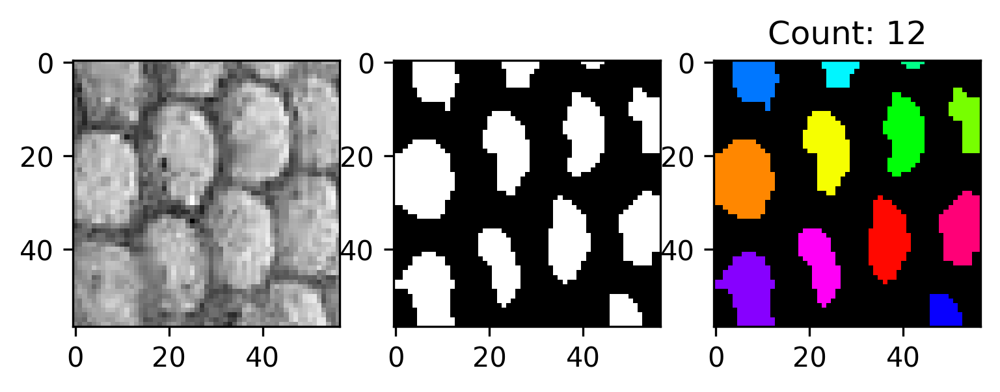

Customized Values used
25 1


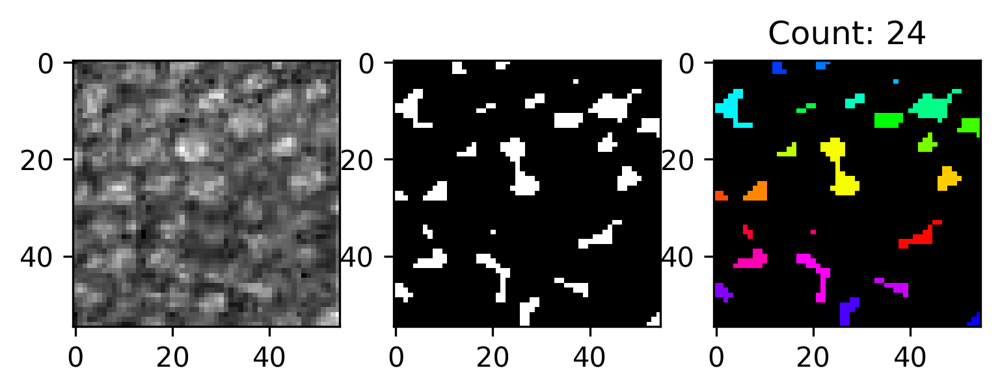

Customized Values used
65 4


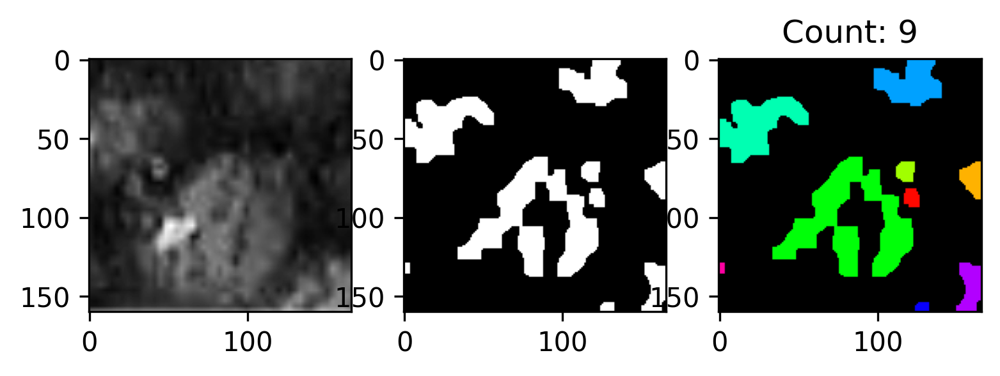

Customized Values used
65 4


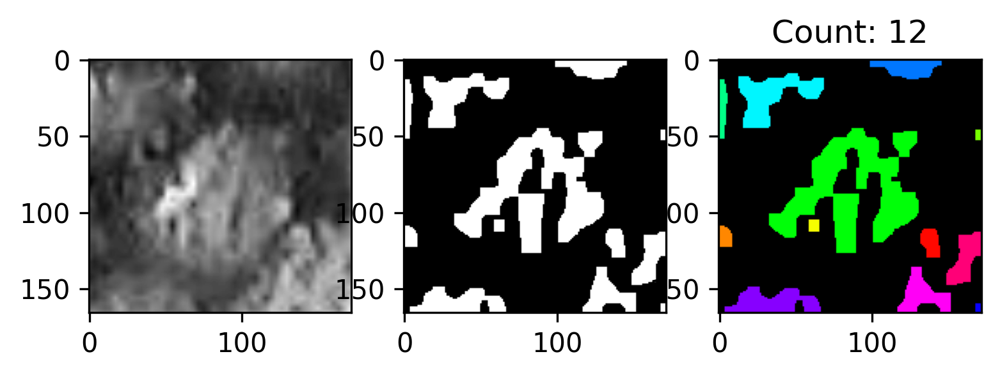

Customized Values used
15 1


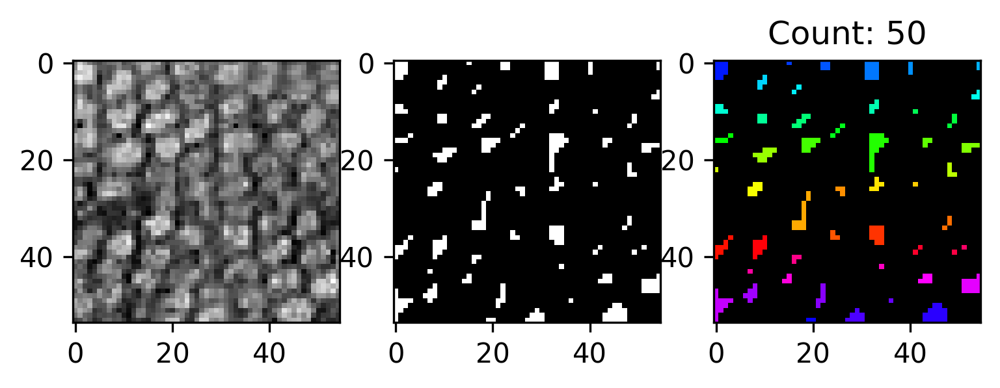

Customized Values used
15 1


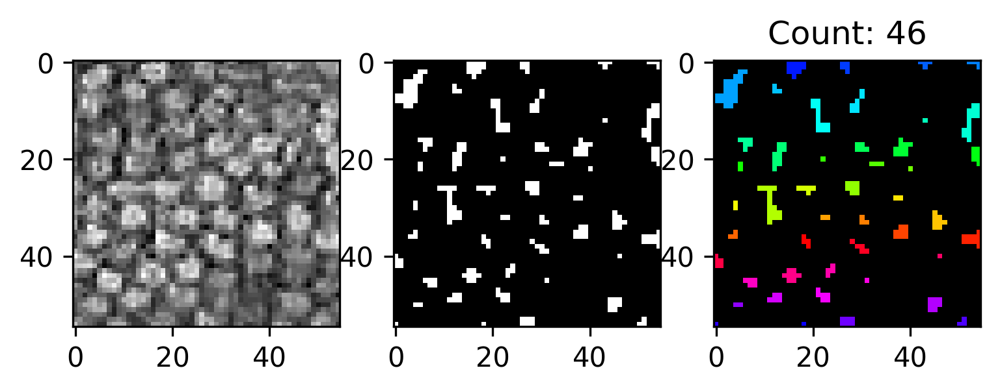

Customized Values used
25 1


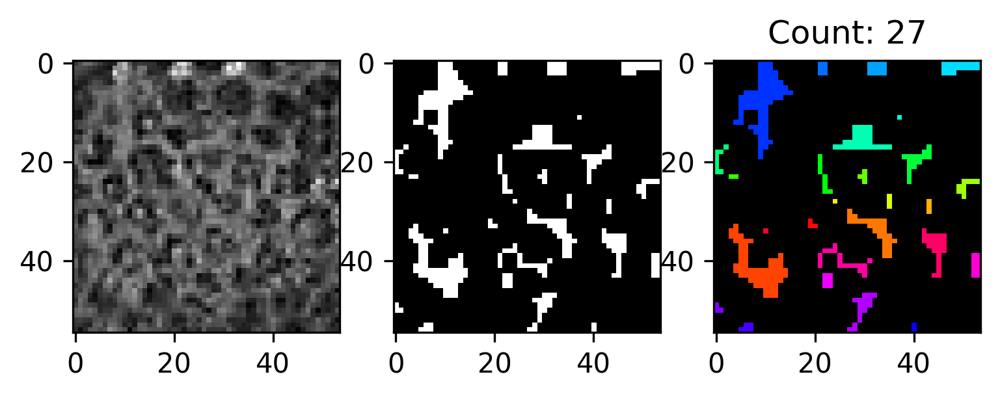

Customized Values used
65 4


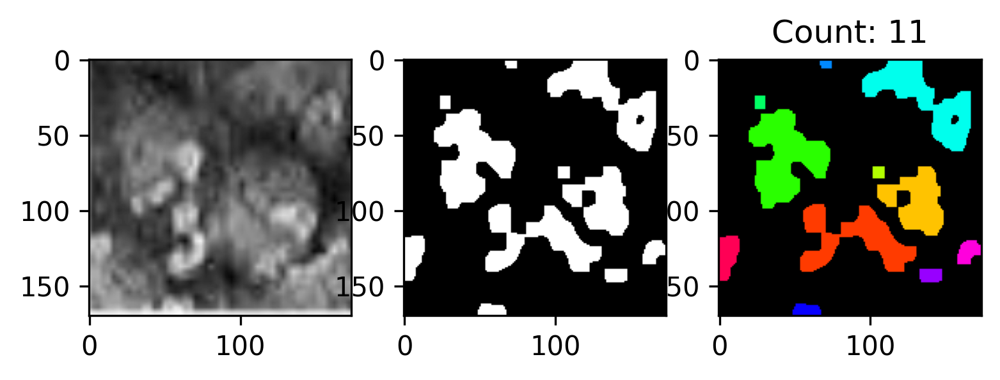

Customized Values used
65 4


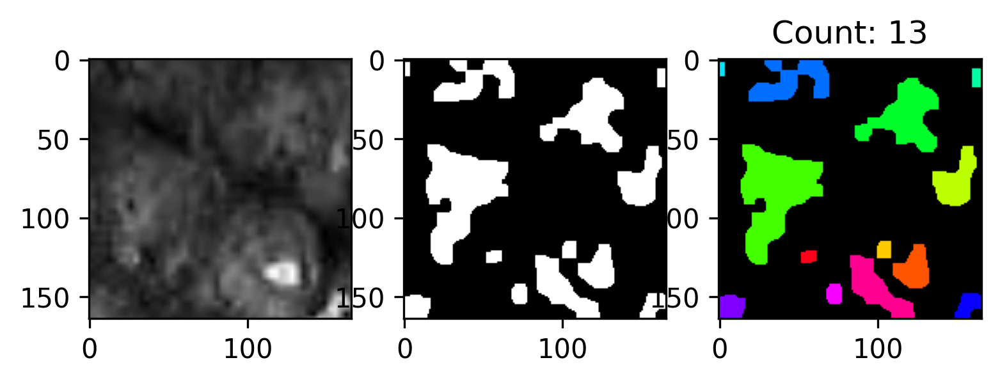

Customized Values used
25 1


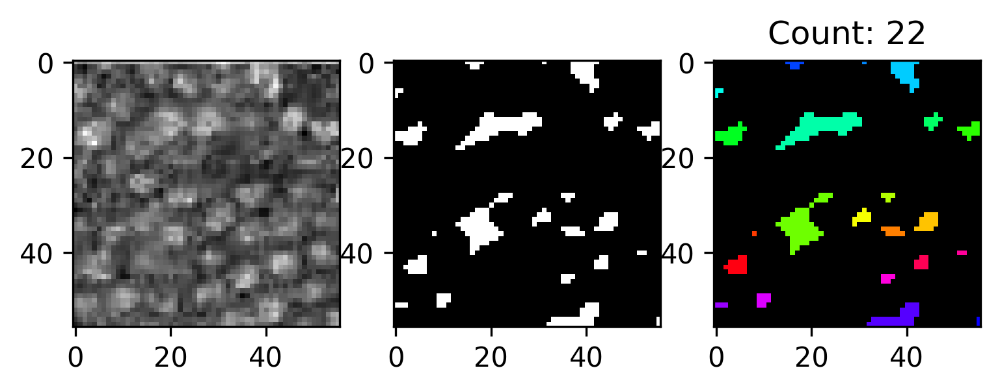

Customized Values used
25 1


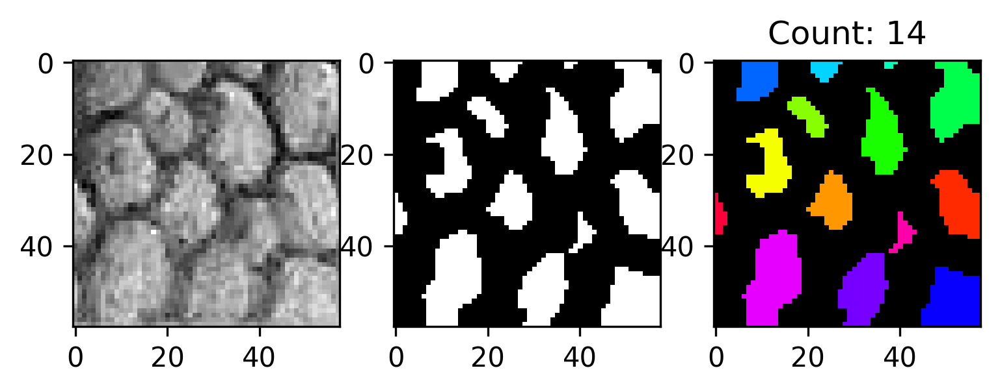

Customized Values used
25 1


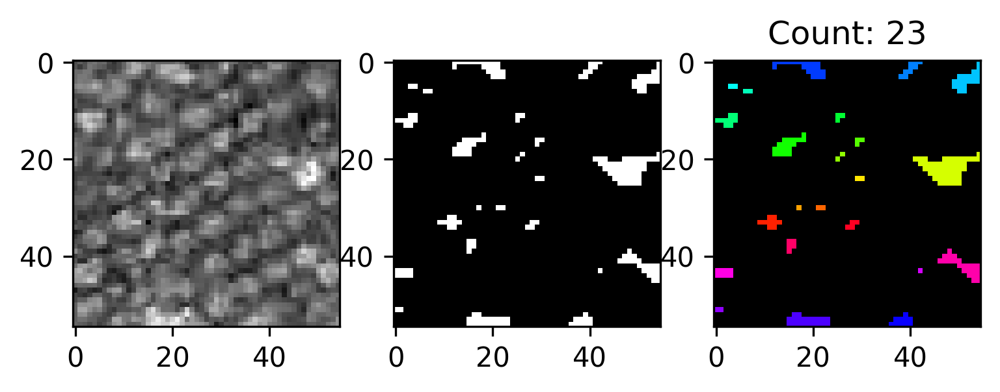

Customized Values used
65 4


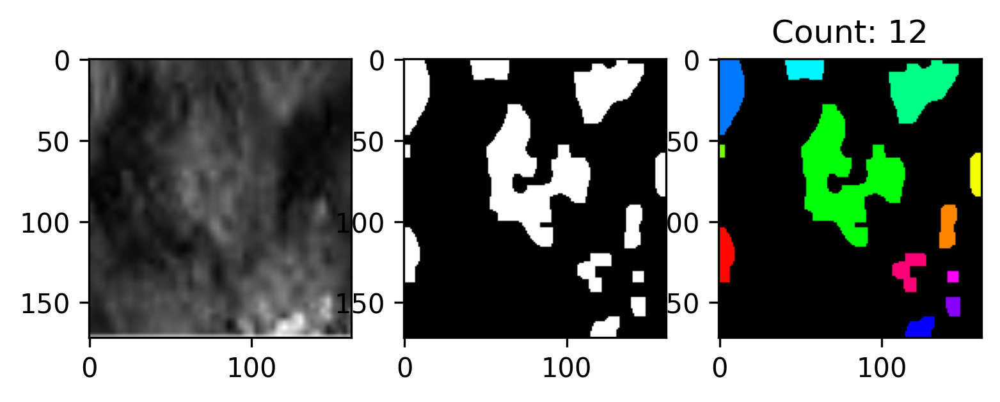

Customized Values used
25 1


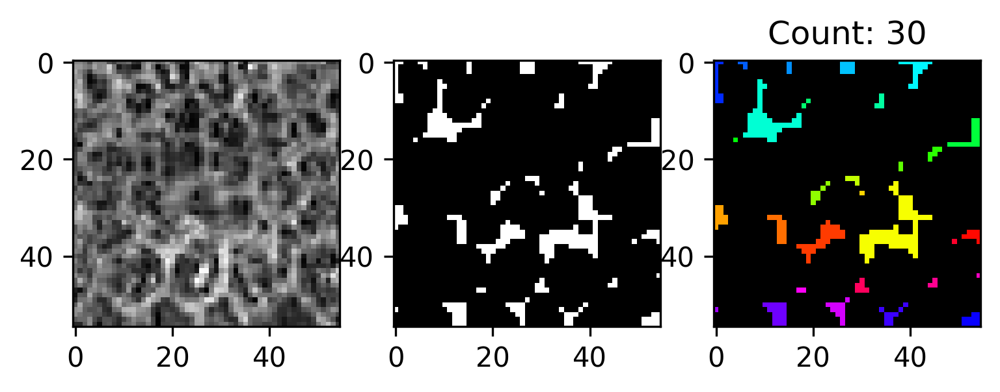

Customized Values used
25 1


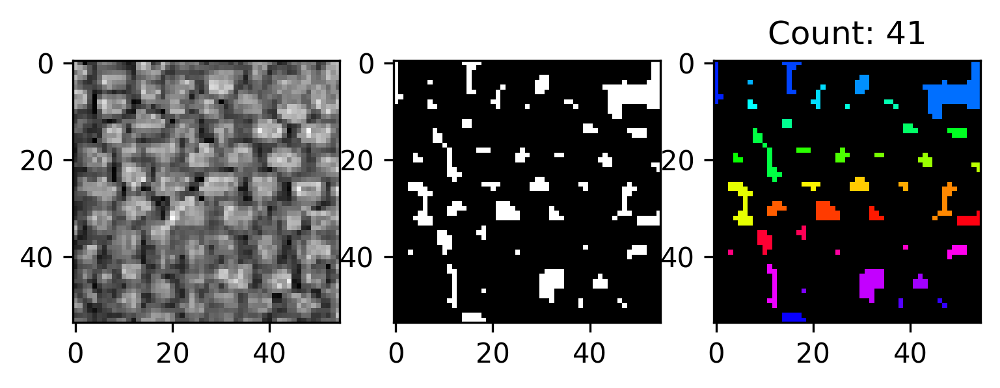

Customized Values used
25 1


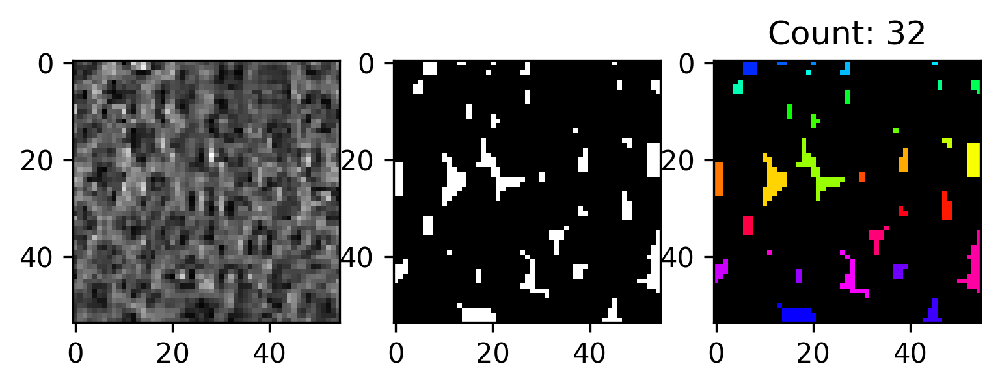

Customized Values used
65 4


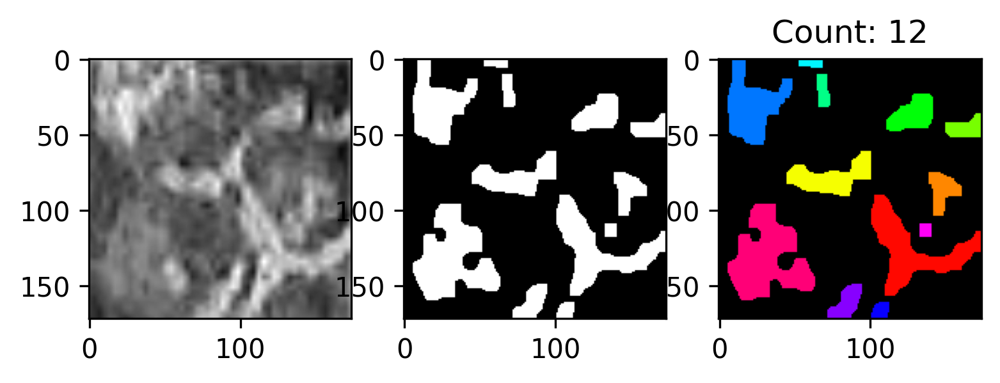

Customized Values used
25 1


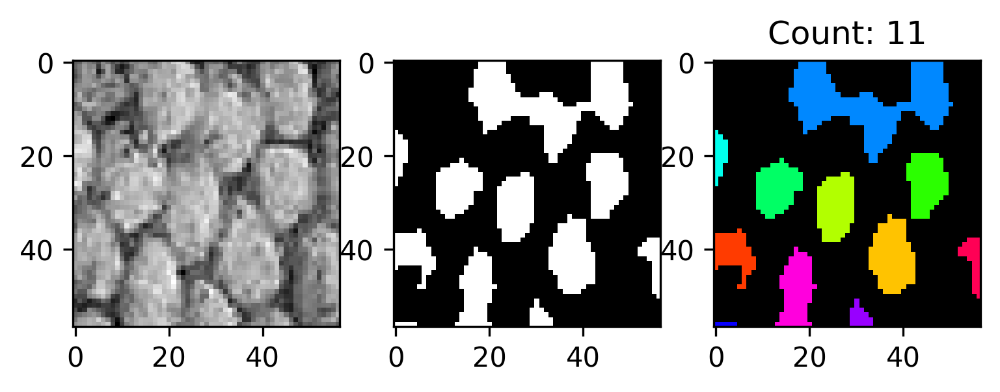

Customized Values used
25 1


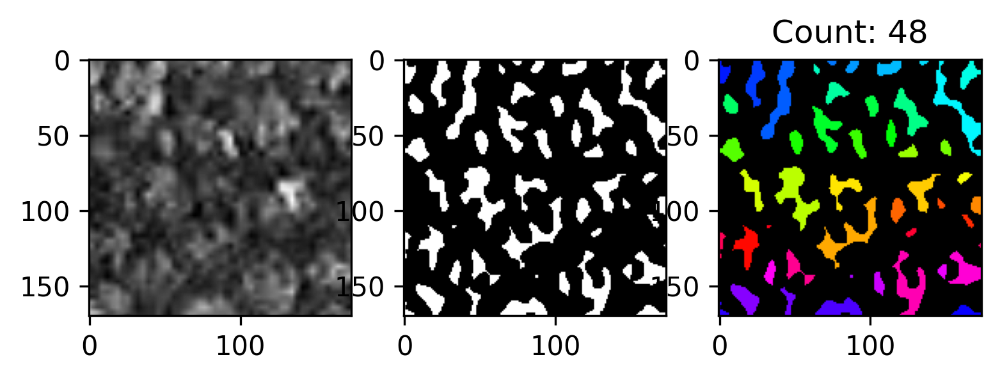

Customized Values used
45 4


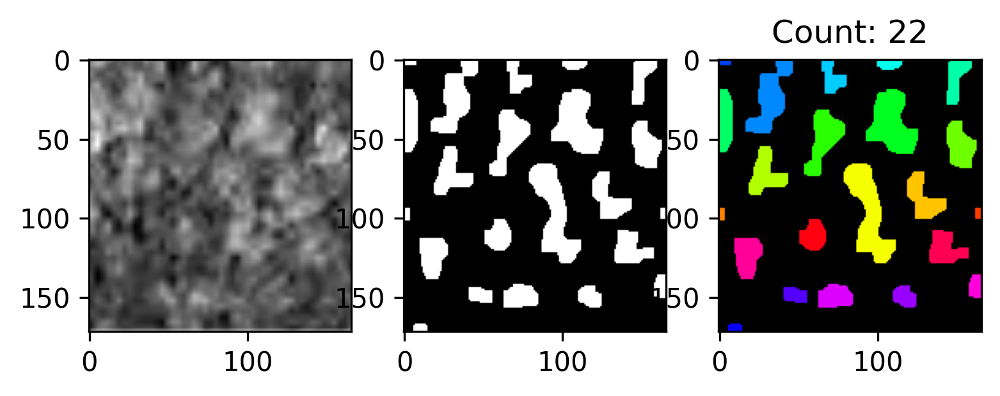

Customized Values used
25 1


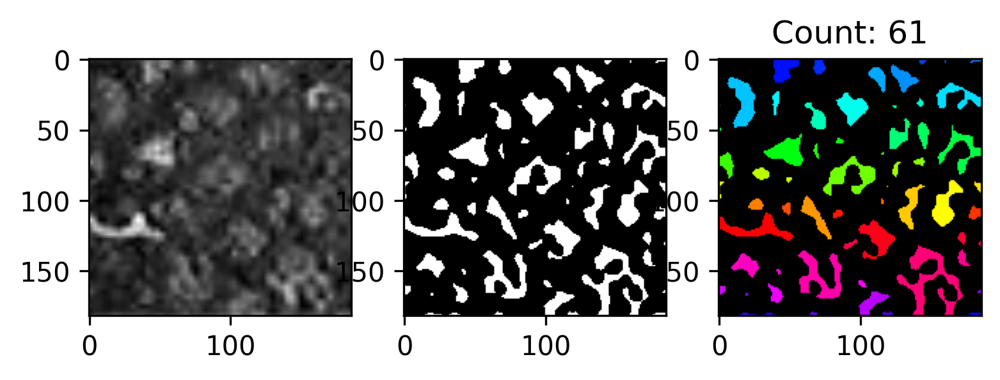

Customized Values used
25 1


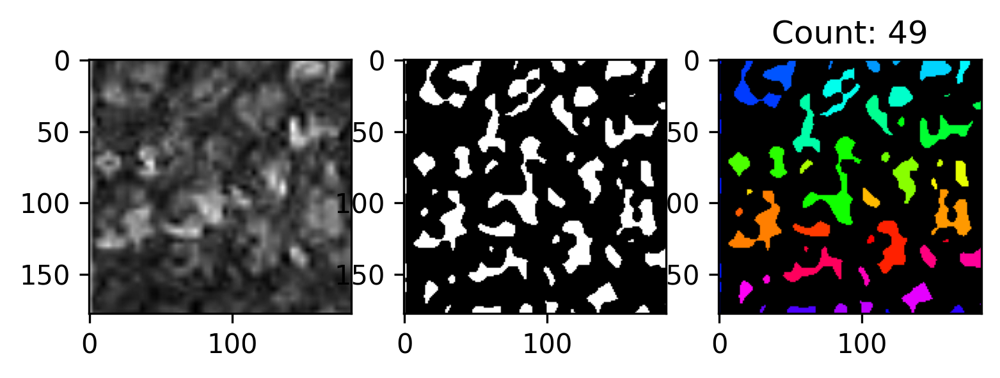

Customized Values used
25 1


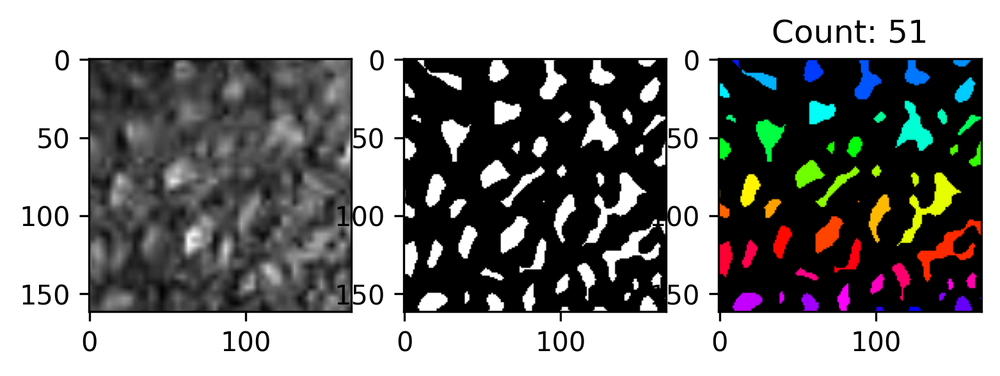

Customized Values used
25 1


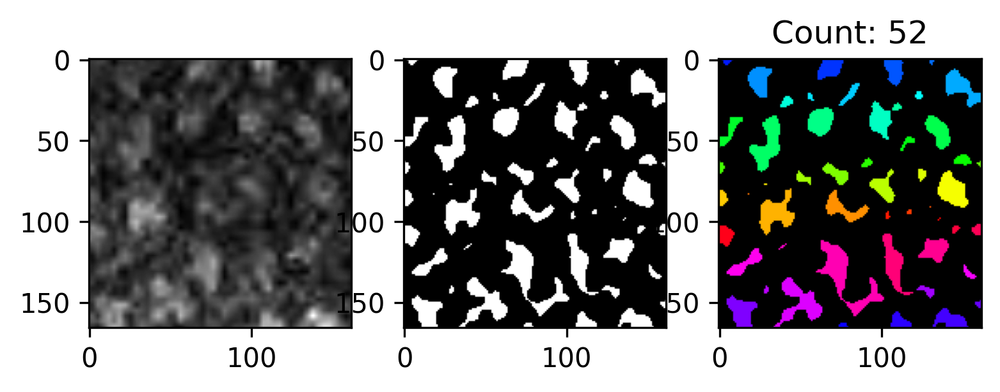

Customized Values used
15 1


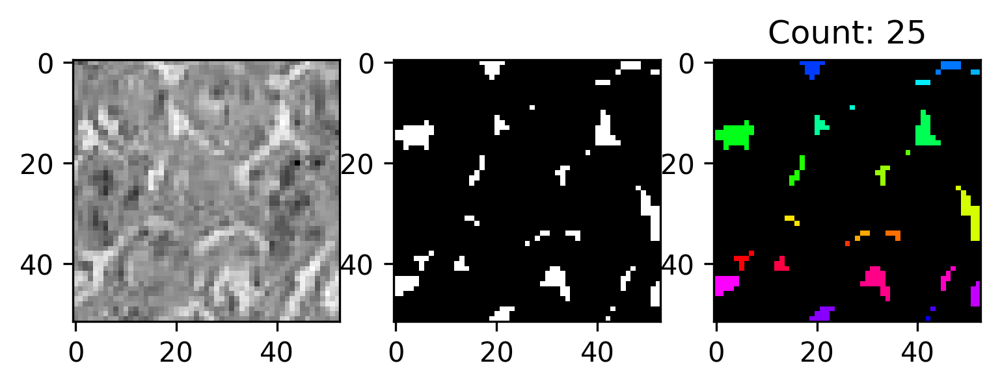

Customized Values used
25 1


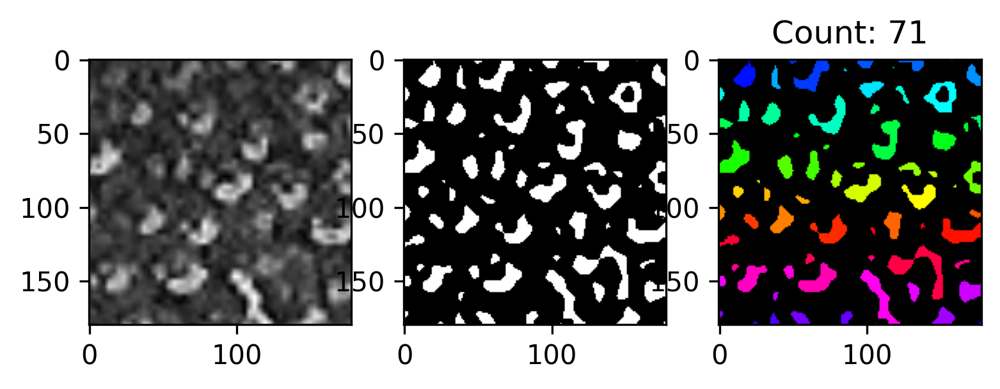

Customized Values used
25 1


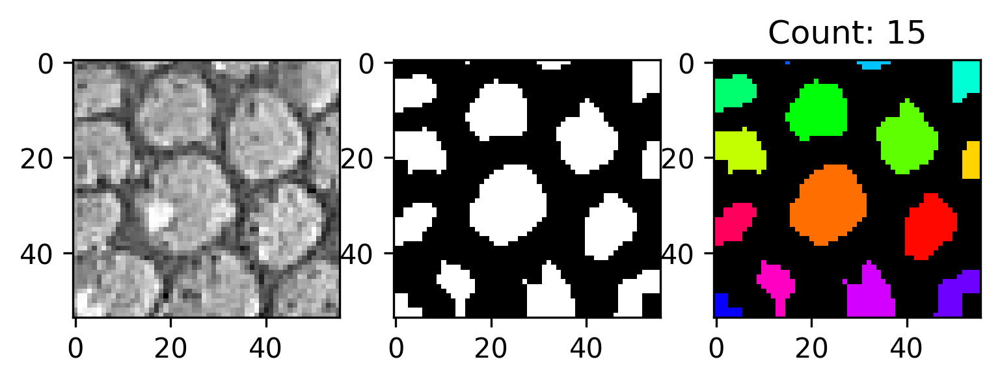

Customized Values used
25 1


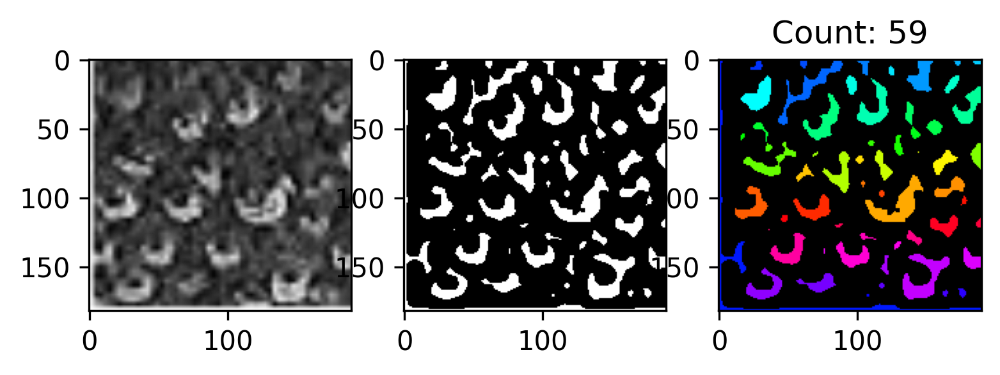

Customized Values used
25 1


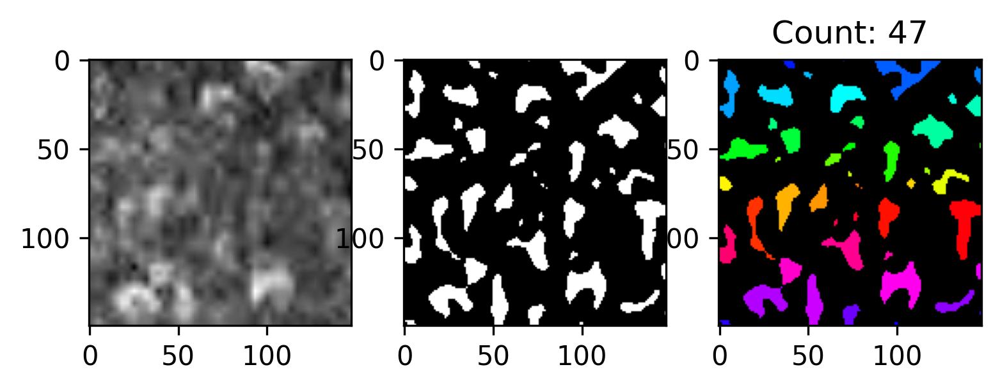

Customized Values used
25 1


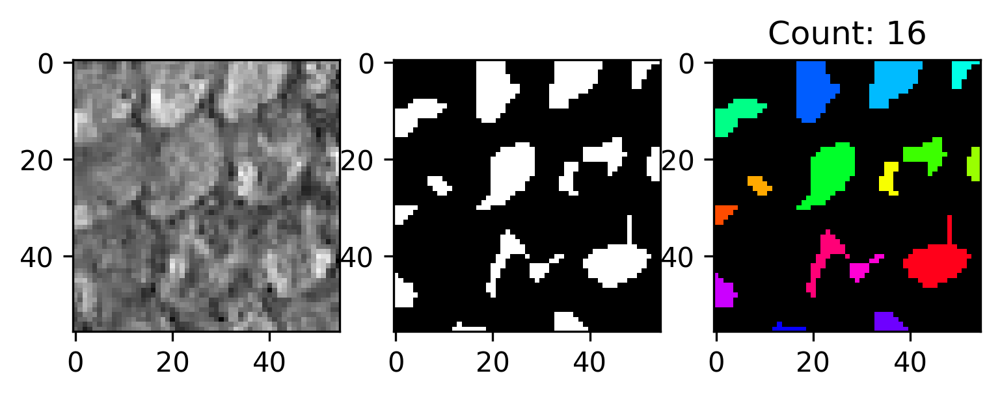

Customized Values used
25 1


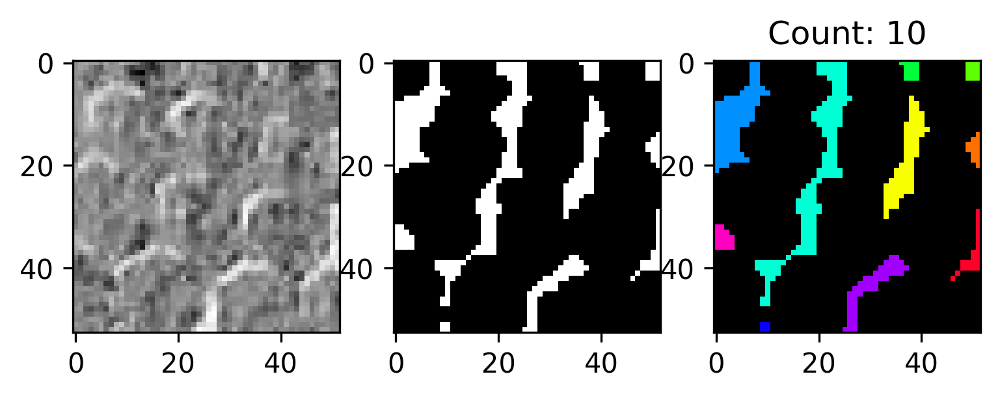

Customized Values used
25 1


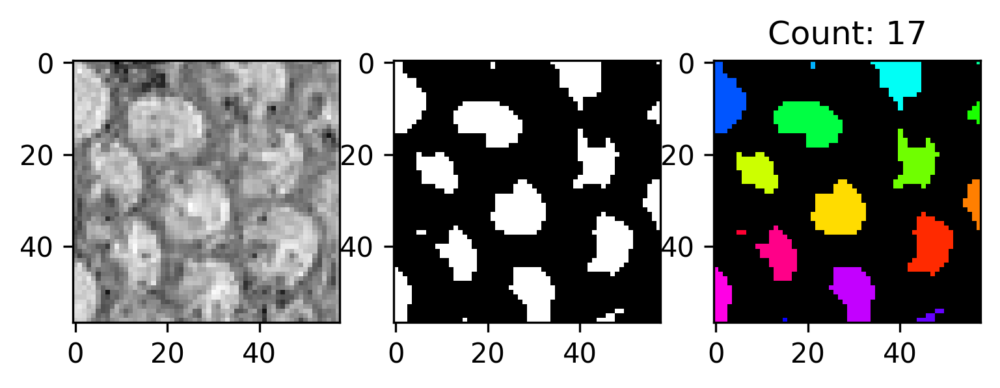

Customized Values used
25 1


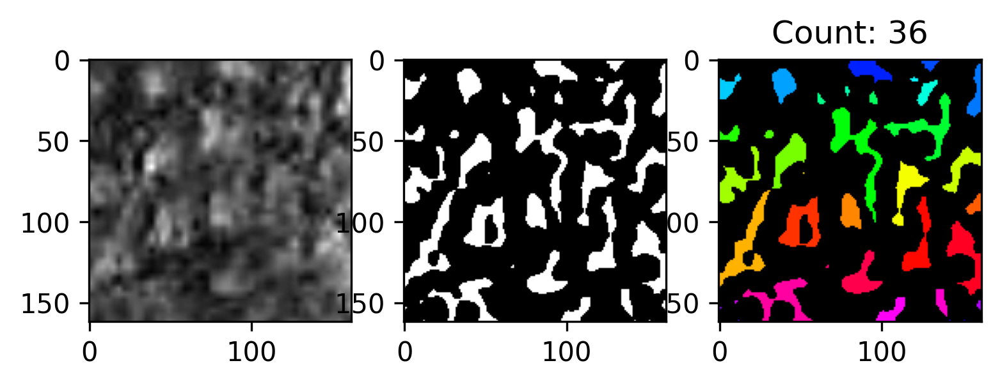

Customized Values used
65 4


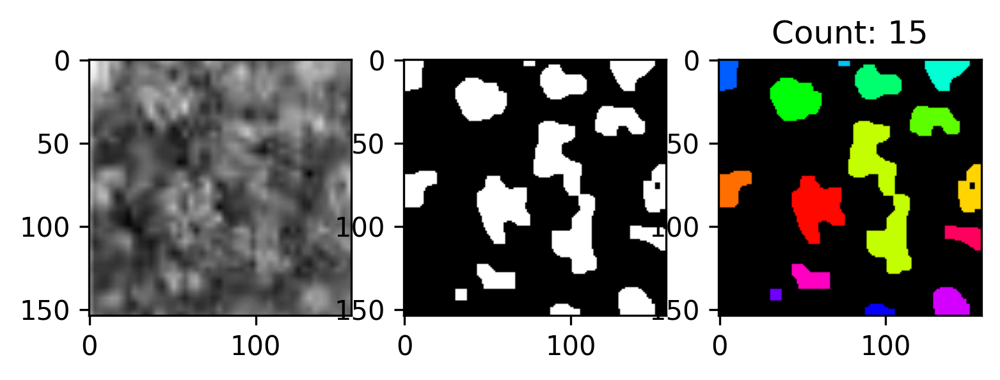

Customized Values used
25 1


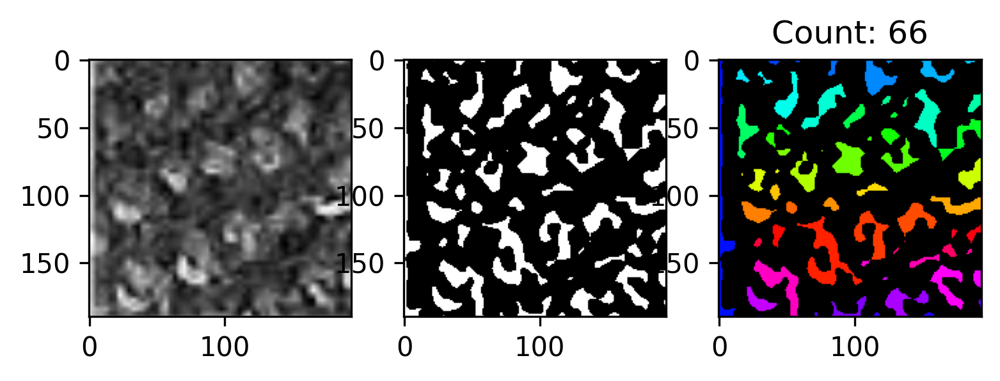

Customized Values used
25 1


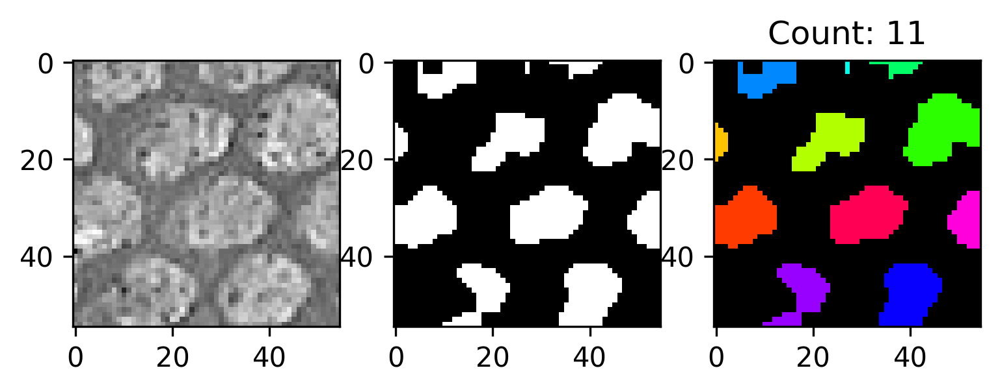

Customized Values used
25 1


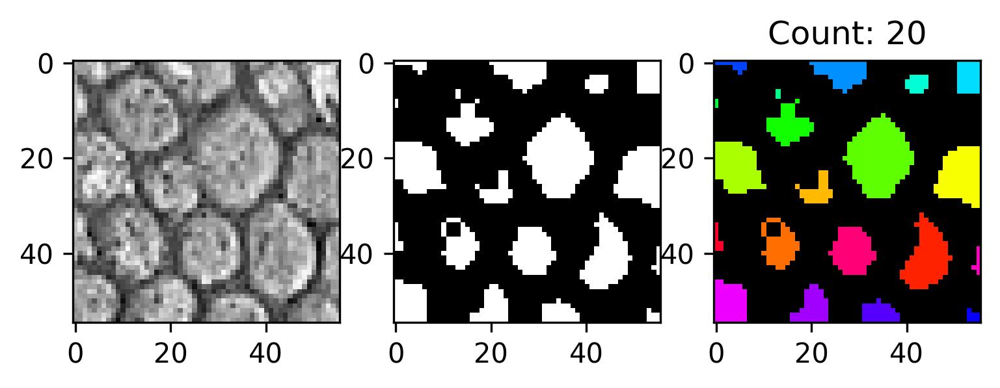

Customized Values used
25 1


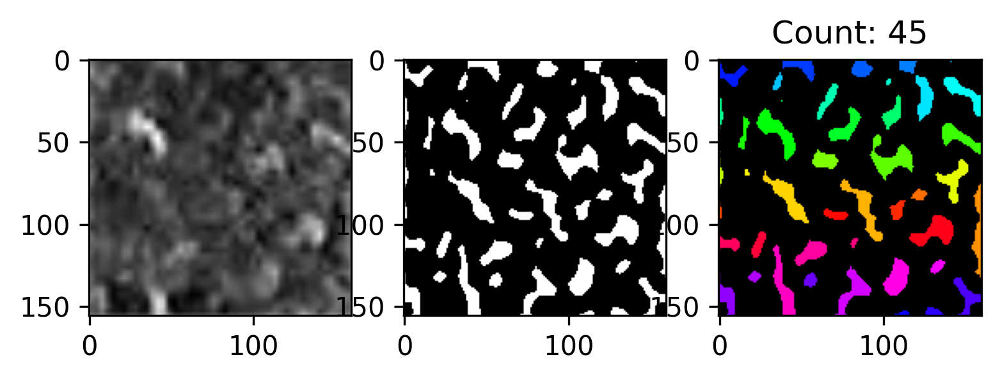

Customized Values used
25 1


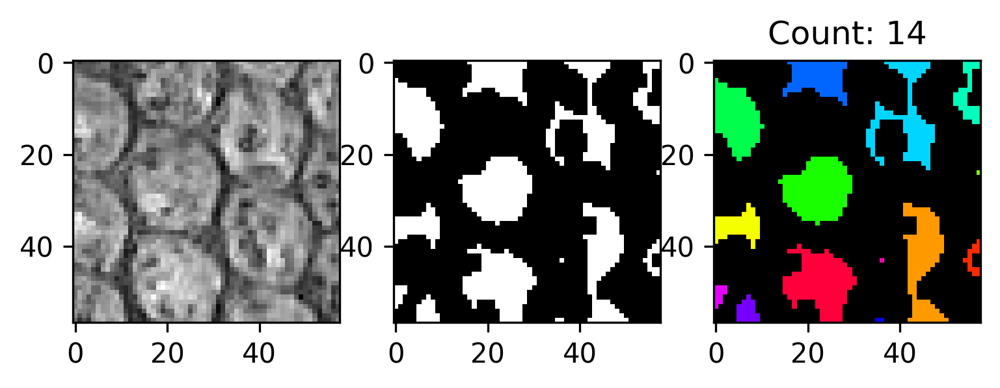

Customized Values used
45 4


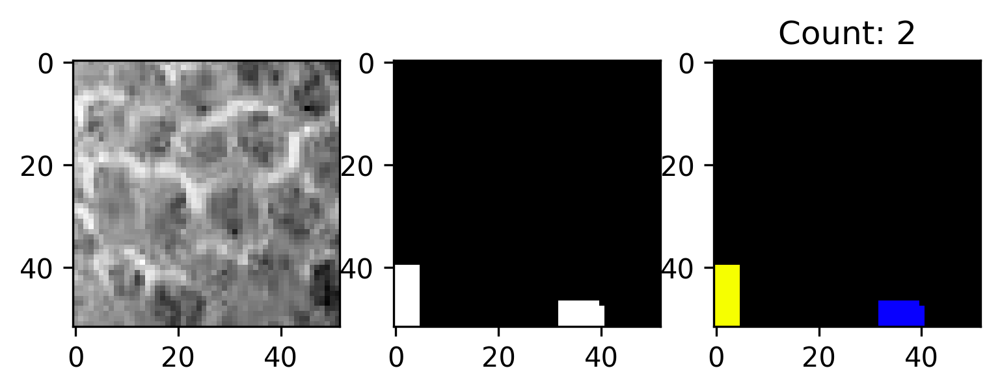

Customized Values used
65 4


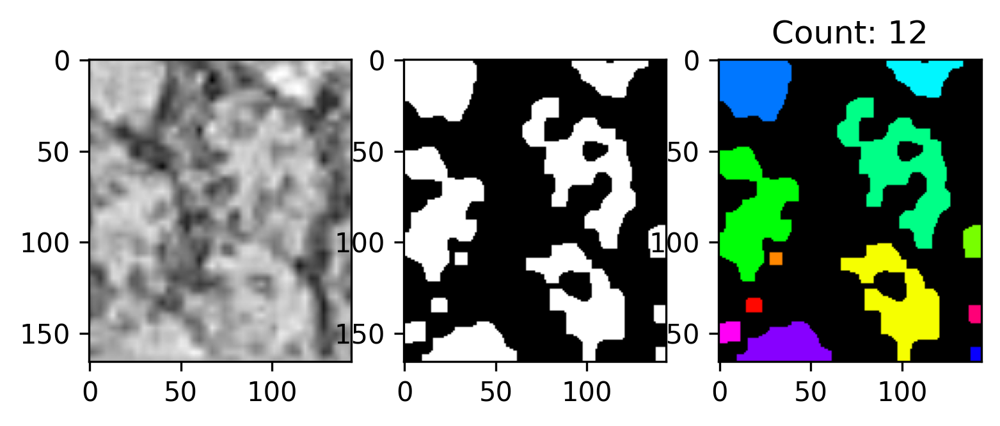

Customized Values used
15 1


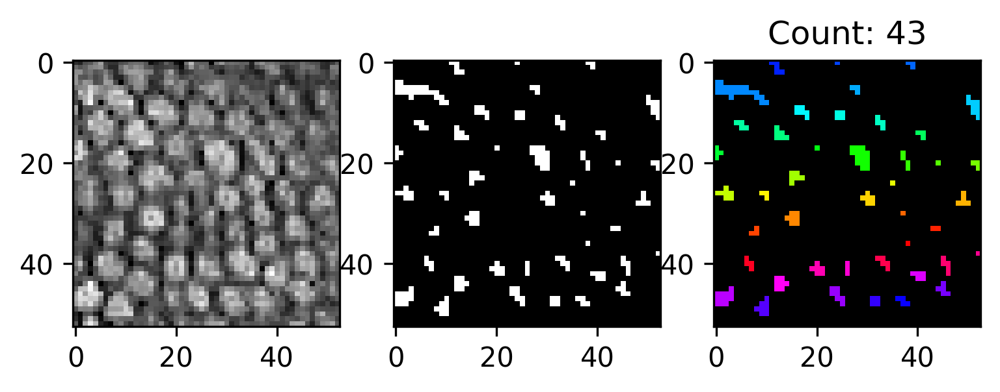

Customized Values used
15 1


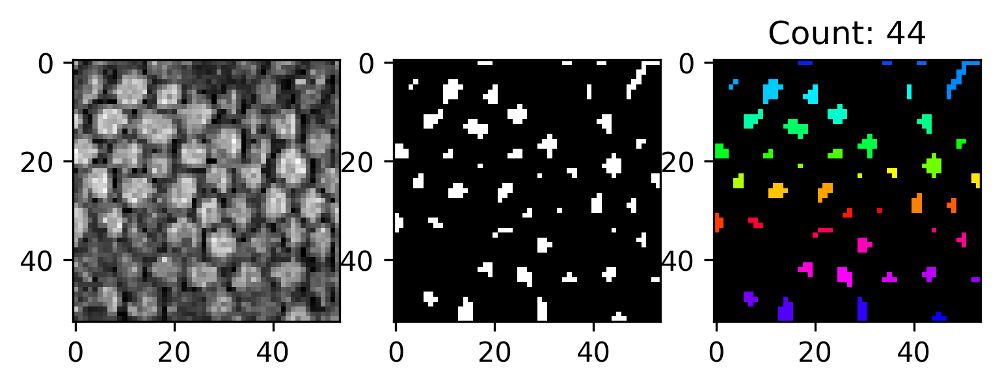

Customized Values used
65 4


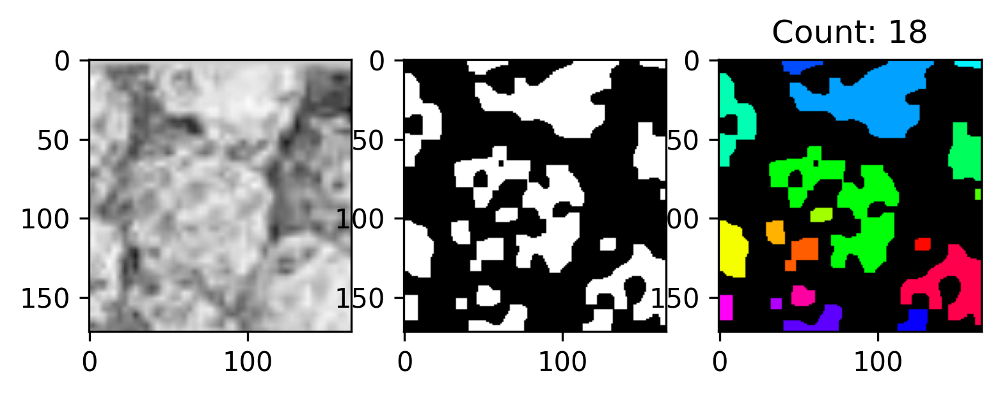

Customized Values used
15 1


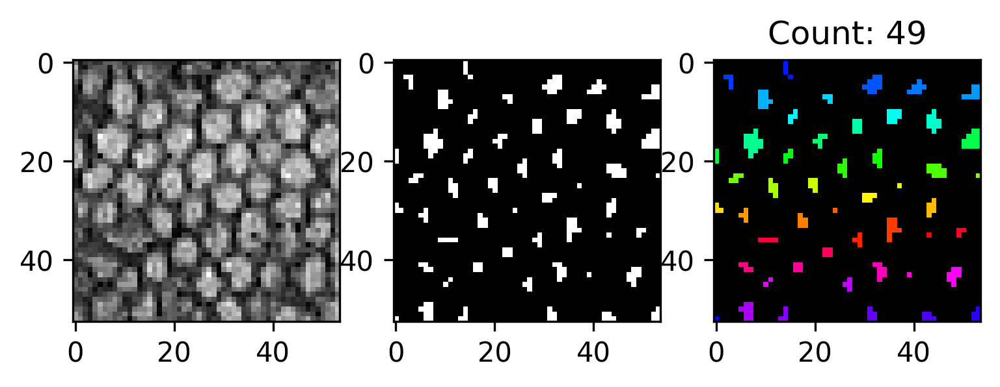

Customized Values used
65 4


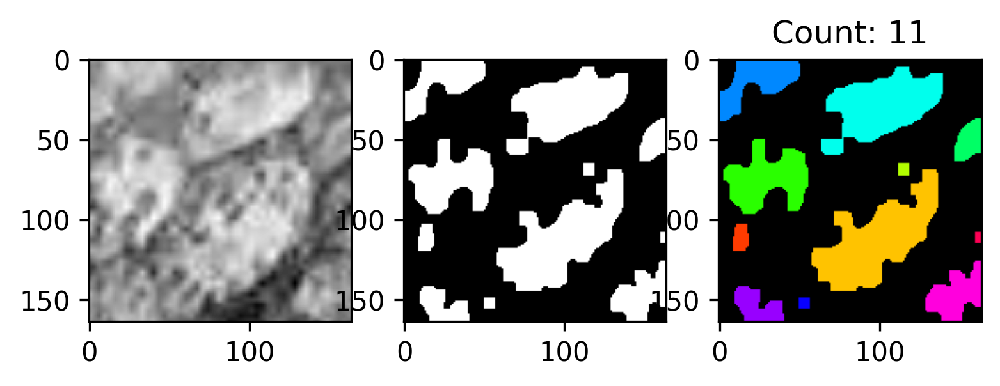

Customized Values used
65 4


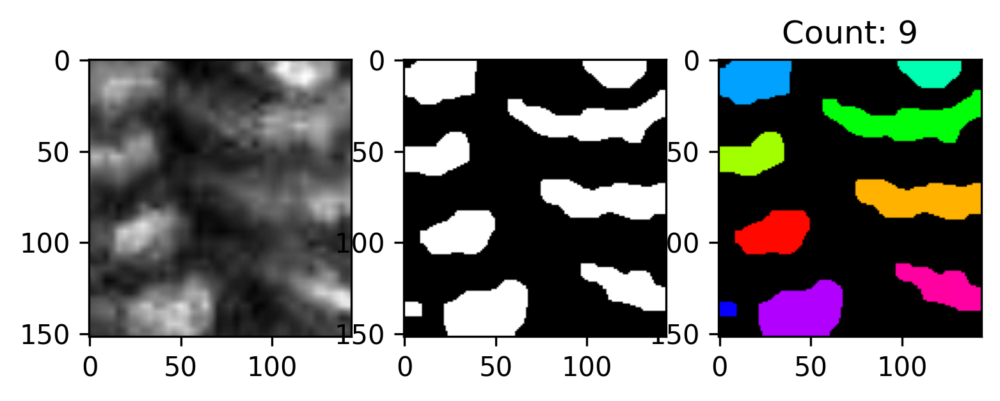

Customized Values used
25 1


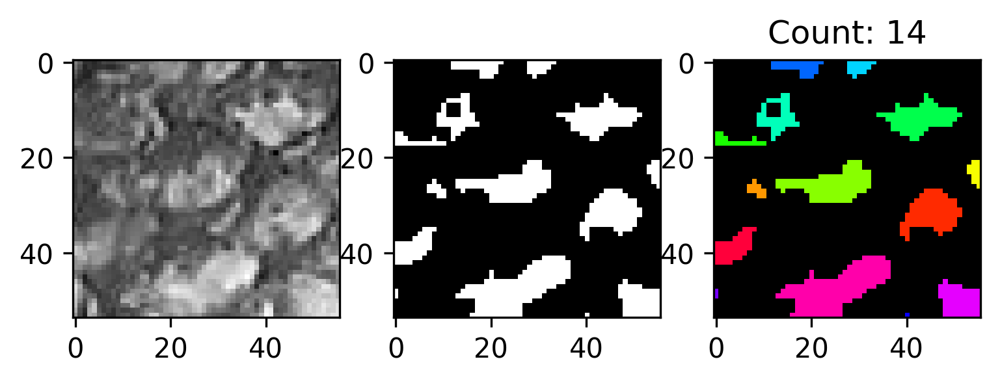

Customized Values used
65 4


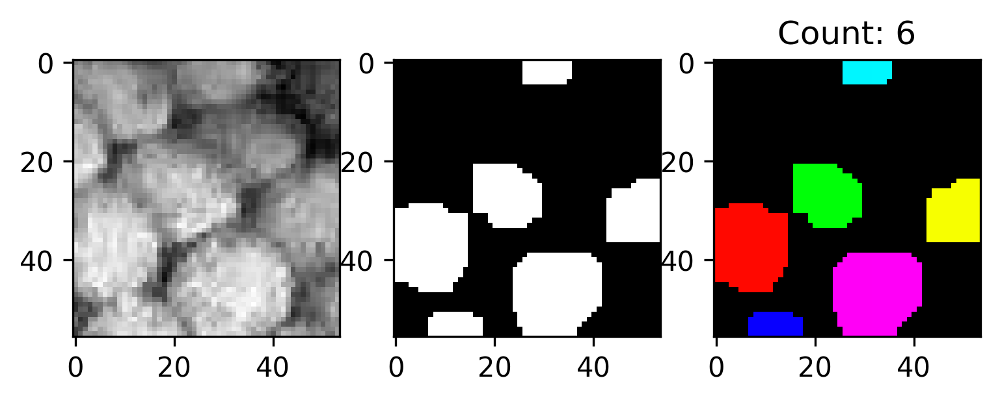

Customized Values used
65 4


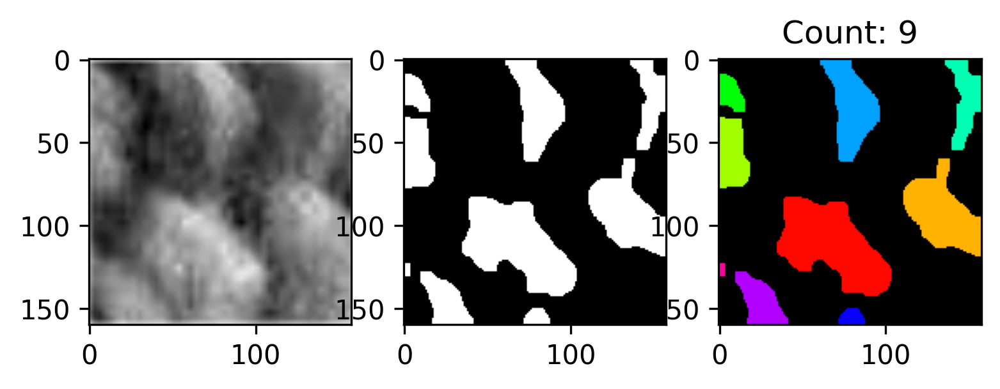

Customized Values used
25 1


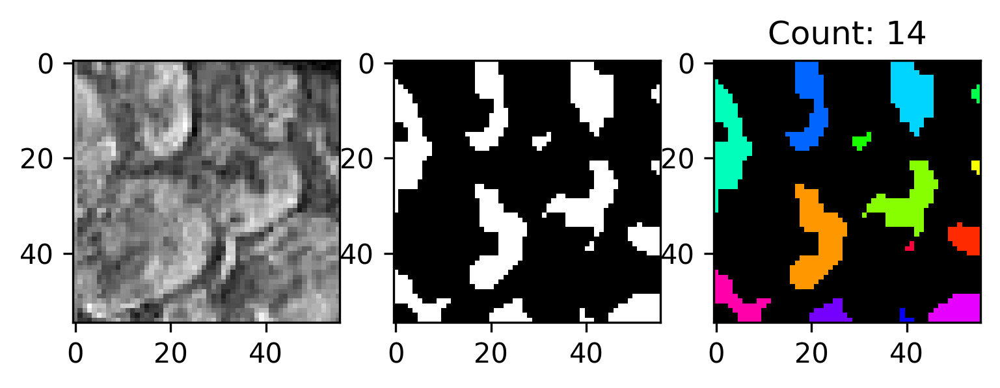

Customized Values used
45 4


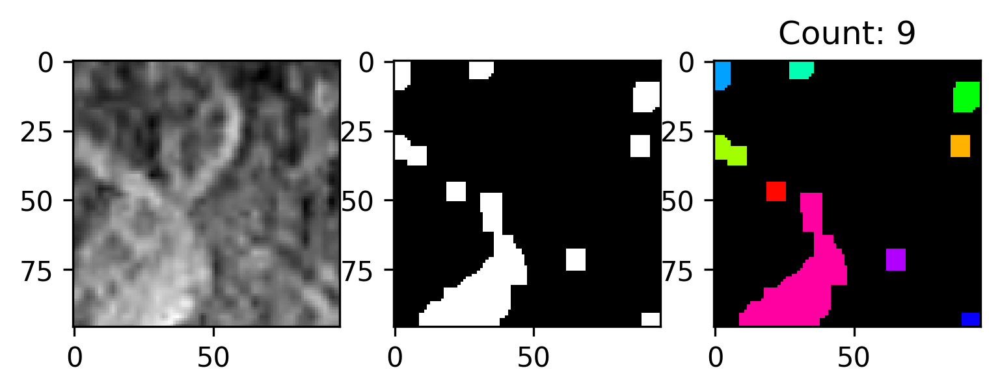

Customized Values used
65 4


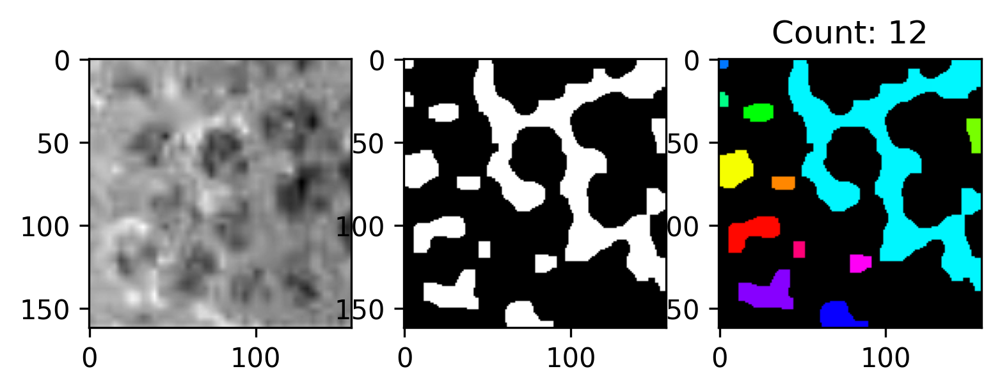

Customized Values used
25 1


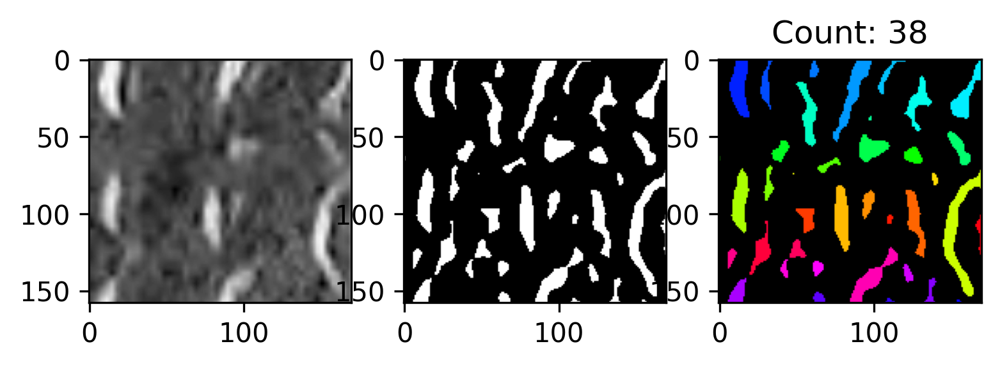

Customized Values used
65 4


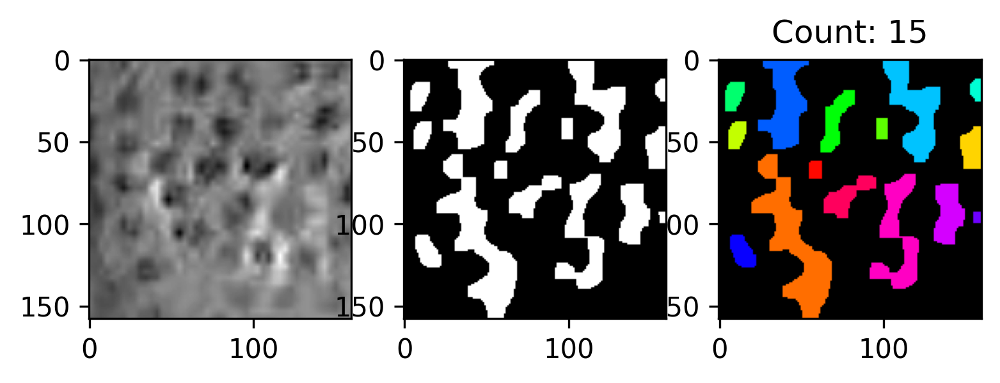

In [6]:
dirname = 'Anolis_cristatellus_images/'
#create an iterator object for img directory
directory = os.scandir(dirname)
images = []
initial_binarization(0, 0, block_size)

In [7]:
initial_binarization(41, 4,[])

In [8]:
all_scale_counts = [i[0] for i in total_stats]
all_sizes = [i[1] for i in total_stats]
#sorts all_sizes so that the sizes of the scales are arranged from largest to␣smallest in array
for array_index in np.arange(len(all_sizes) - 1):
    all_sizes[array_index].sort()
    all_sizes[array_index] = all_sizes[array_index][::-1]
    averages = []
for size_array in all_sizes:
    num_nums = (np.rint(len(size_array)/2)).astype(int)
    averages = np.append(averages, np.average(size_array[0:num_nums]))
print(averages)

[ 143.5         294.         3097.5        3814.                   nan
           nan           nan 4029.         1006.5                  nan
  167.                   nan 2993.                   nan           nan
           nan 1049.8         228.          378.22222222  769.5
  310.          351.625       347.6         284.75                 nan
  165.55555556  125.          150.71428571  393.33333333  108.
           nan   76.5         385.625      1076.5         301.6
  136.75         97.16666667  204.125       168.                   nan
 2661.                   nan           nan 2889.6                  nan
 2263.75       1072.75         85.         1380.         2588.
  147.5         917.5        6282.5         243.5        3702.        ]


In [9]:
def overlay(bw_img, color_mask, w1=0.2, w2=0.95):
    a = cv2.cvtColor(bw_img, cv2.COLOR_GRAY2RGB)
    a -= np.min(a)
    a = a/np.max(a)*255
    a = np.clip(a, a_min=0, a_max=255).astype(int)
    #a = np.array([[i.tolist()+[0] if np.max(i)==0 else i.tolist()+[255] for i␣,in j] for j in a])
    b = np.clip(color_mask, a_min=0, a_max=255).astype(int)
    #b = np.array([[i.tolist()+[255] for i in j] for j in b])
    c = cv2.addWeighted(b,w1,a,w2,0)
    return c

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE
Images 55
2
14.35
scales: 12
212019Ventral-NoFlash-3.png
25


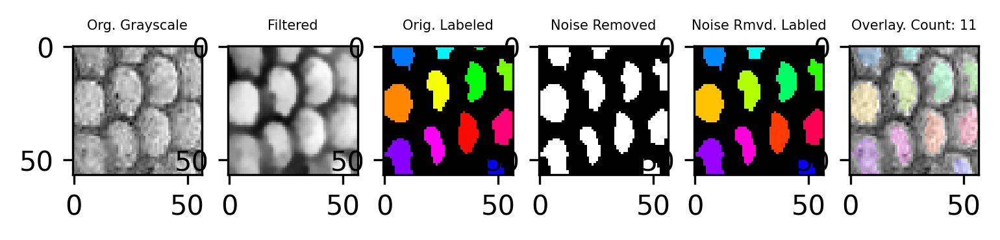

2
29.4
scales: 24
212019Dorsal-NoFlash-2.png
25


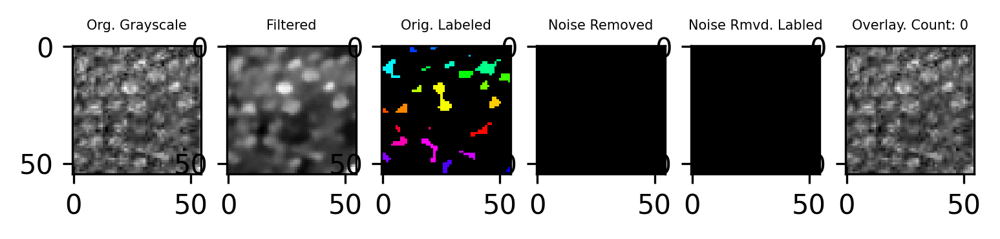

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
309.75
scales: 9
251165Ventral-NoFlash-2.png
65


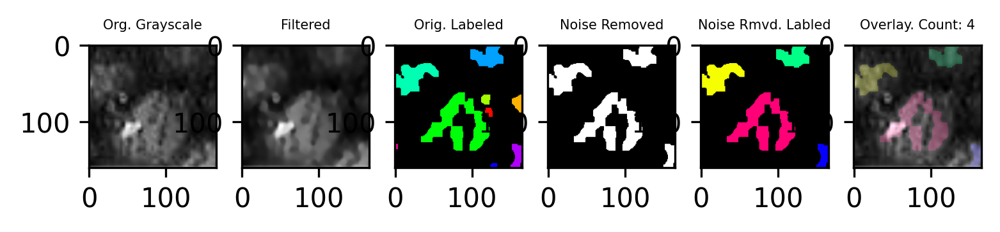

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
381.4
scales: 12
251165Ventral-Flash-3.png
65


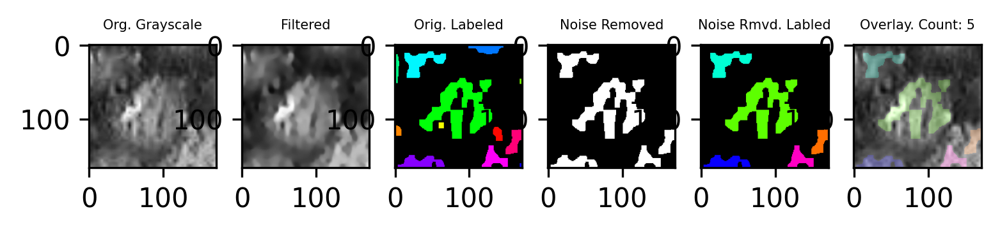

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 50
212018Dorsal-NoFlash-3.png
15


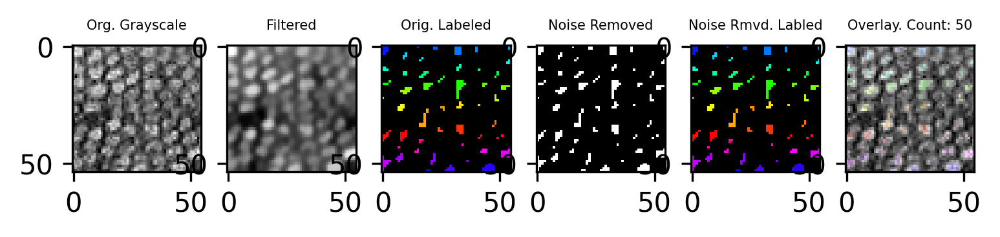

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 46
212018Dorsal-NoFlash-2.png
15


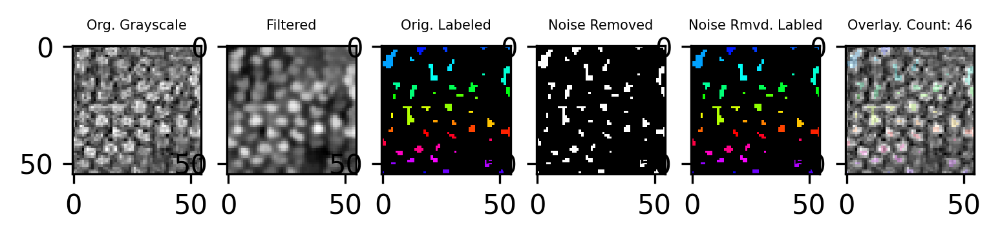

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 27
214993Dorsal-NoFlash-1.png
25


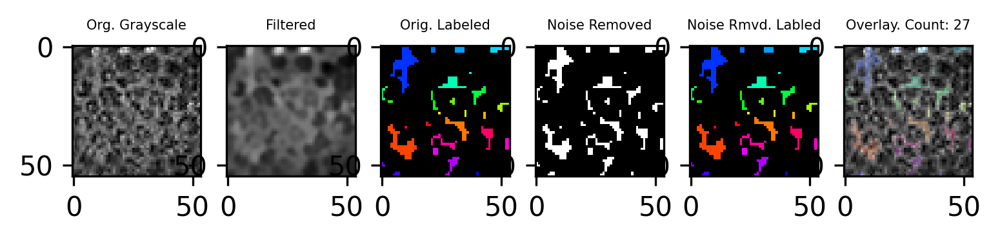

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
402.9
scales: 11
251165Ventral-Flash-2.png
65


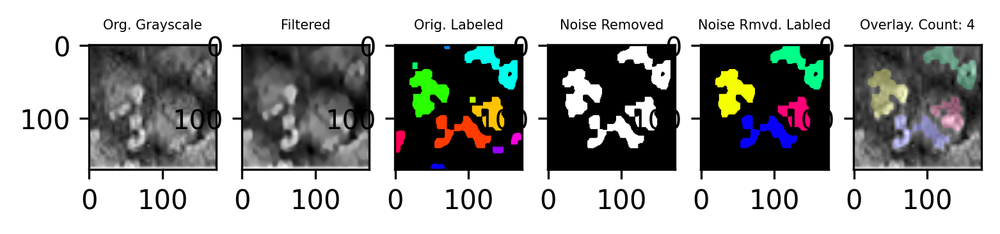

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
100.65
scales: 13
251165Ventral-NoFlash-3.png
65


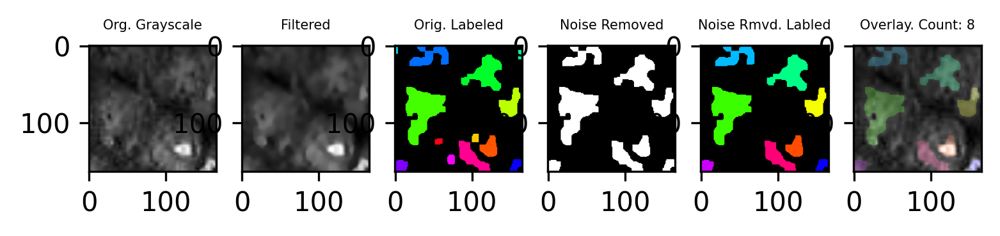

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 22
212019Dorsal-NoFlash-3.png
25


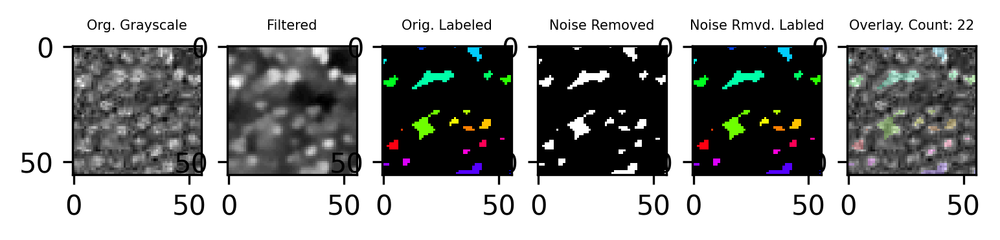

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
16.7
scales: 14
212019Ventral-NoFlash-2.png
25


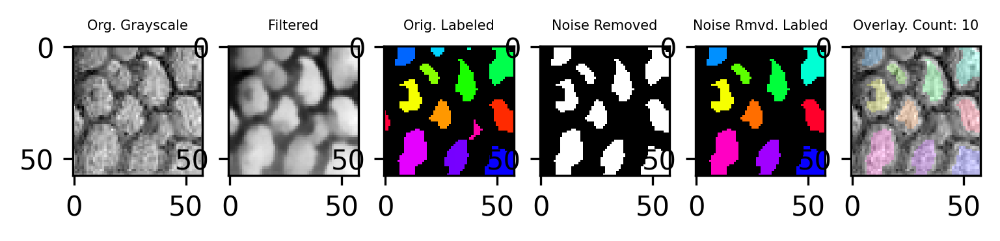

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 23
212019Dorsal-NoFlash-1.png
25


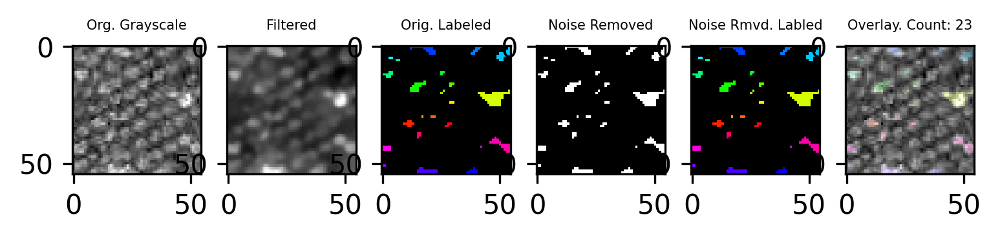

2
299.3
scales: 12
251165Ventral-NoFlash-1.png
65


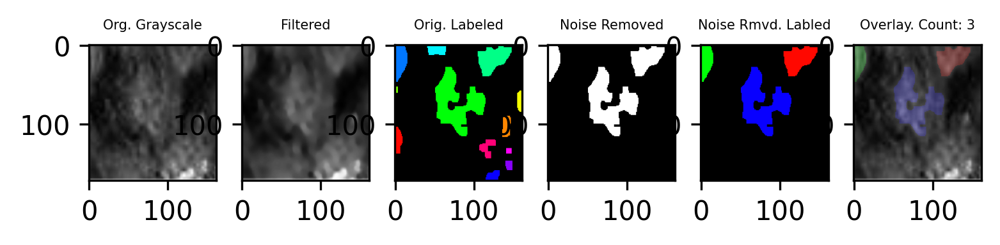

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 30
214993Dorsal-NoFlash-3.png
25


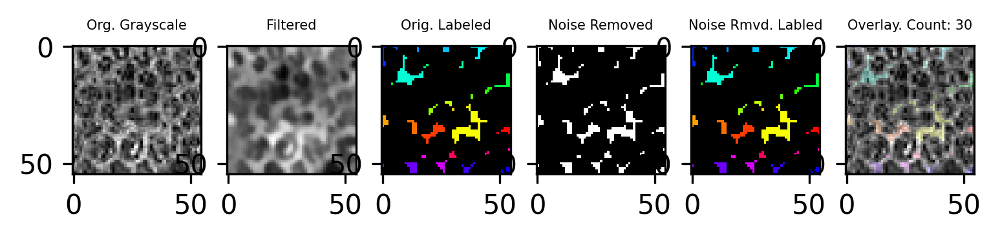

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 41
212018Dorsal-NoFlash-1.png
25


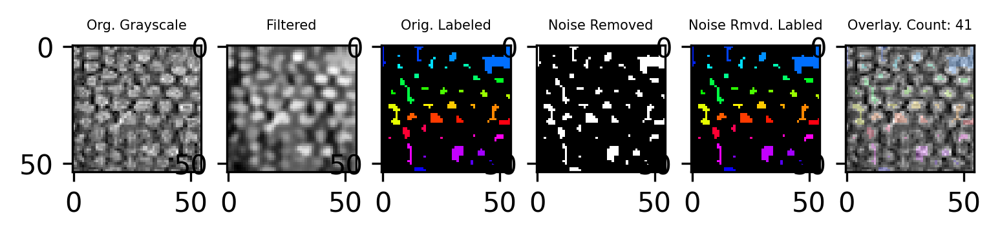

2
nan
scales: 32
214993Dorsal-NoFlash-2.png
25


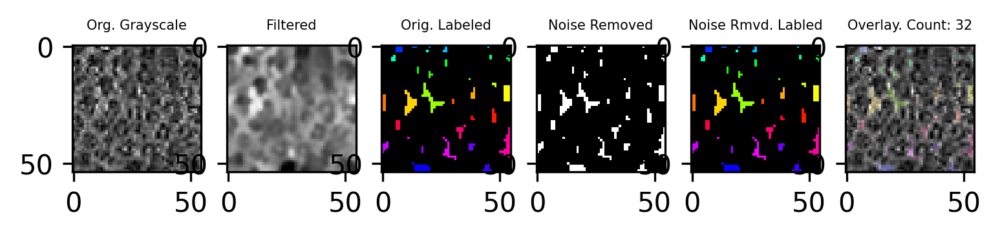

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
104.97999999999999
scales: 12
251165Ventral-Flash-1.png
65


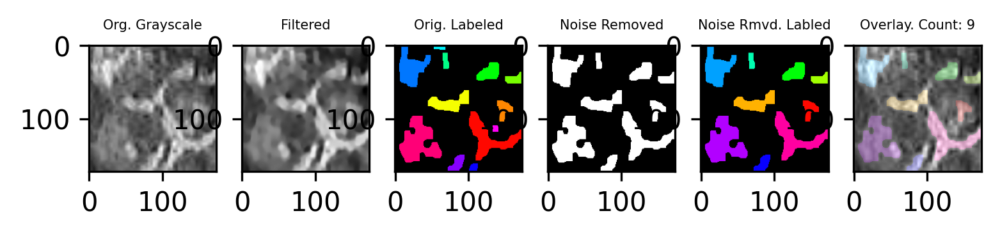

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
22.8
scales: 11
212019Ventral-NoFlash-1.png
25


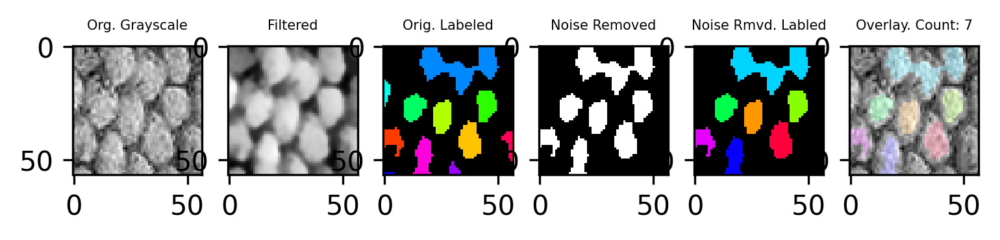

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
37.82222222222222
scales: 48
226121Dorsal-NoFlash-2.png
25


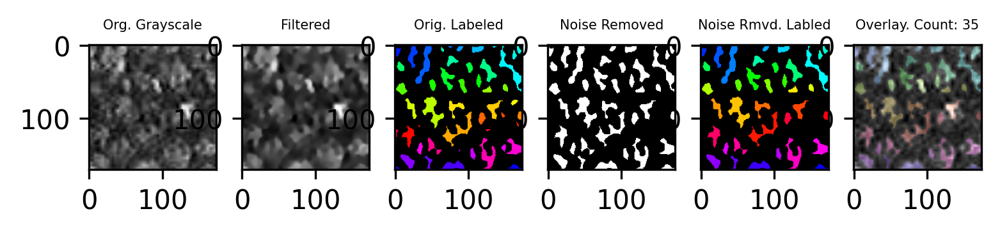

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
76.95
scales: 22
226123Dorsal-NoFlash-1.png
45


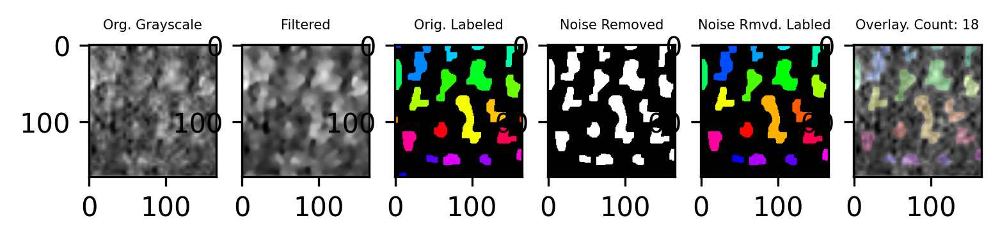

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
31.0
scales: 61
226121Dorsal-NoFlash-3.png
25


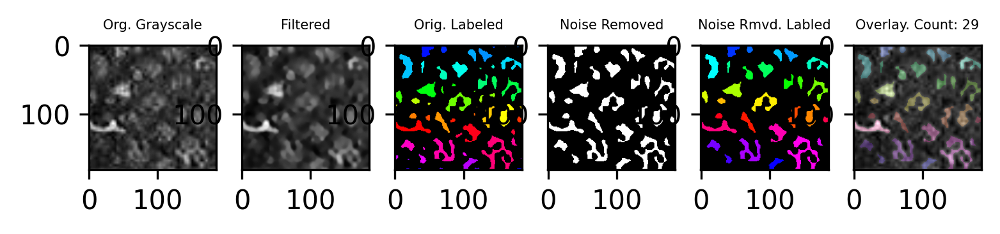

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
35.1625
scales: 49
226121Dorsal-NoFlash-1.png
25


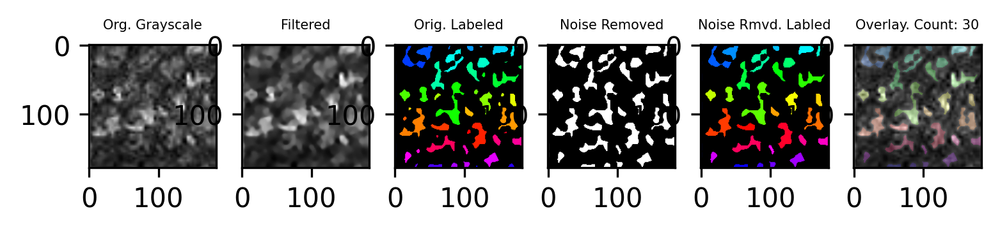

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
34.760000000000005
scales: 51
226123Dorsal-NoFlash-2.png
25


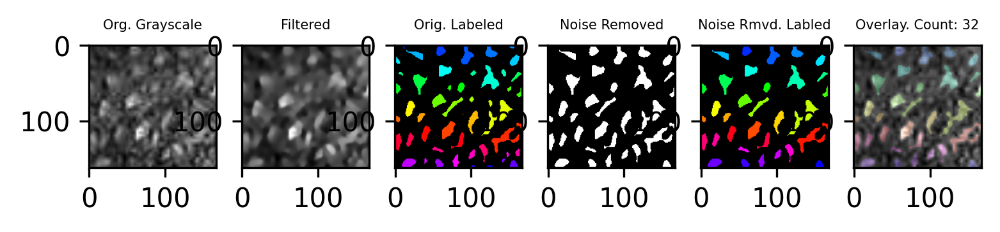

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
28.475
scales: 52
226123Dorsal-NoFlash-3.png
25


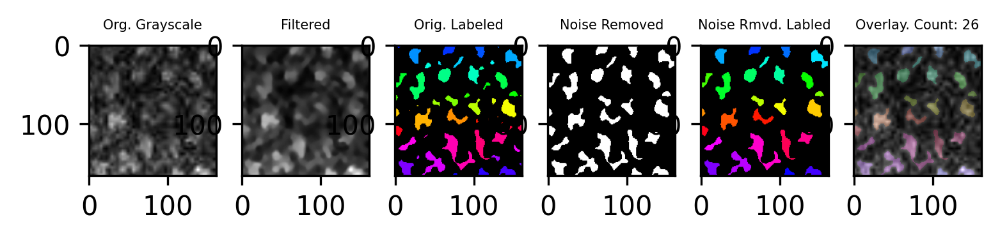

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 25
214993Ventral-Flash-3.png
15


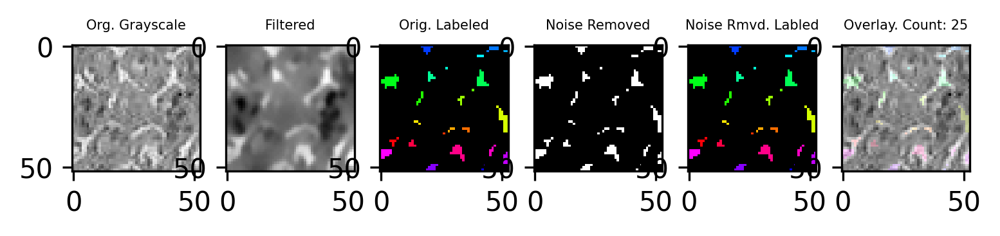

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
16.555555555555554
scales: 71
226123Dorsal-Flash-2.png
25


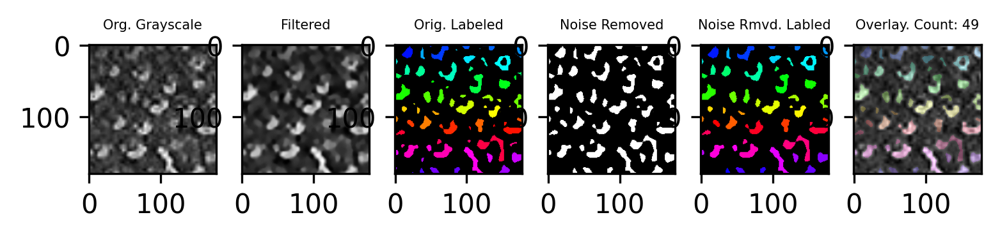

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
12.5
scales: 15
212018Ventral-NoFlash-1.png
25


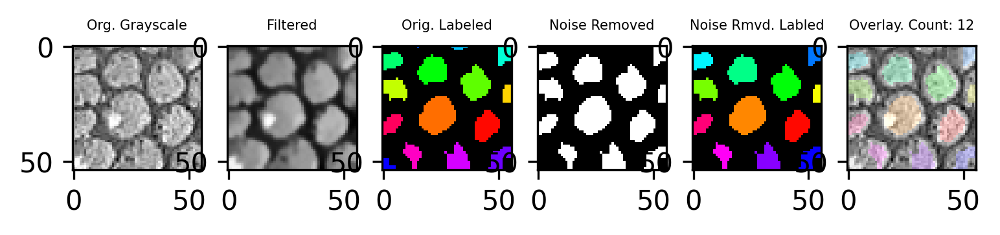

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
15.071428571428573
scales: 59
226123Dorsal-Flash-3.png
25


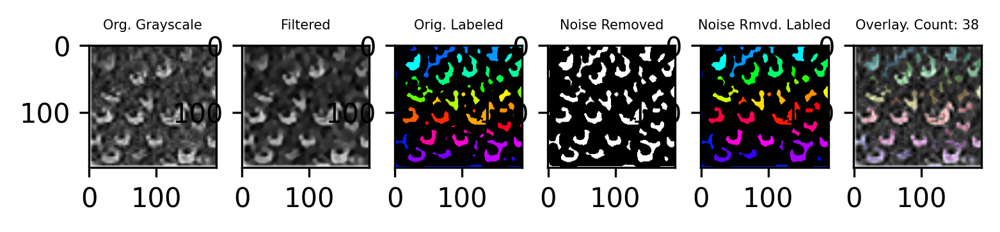

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
39.33333333333333
scales: 47
251165Dorsal-NoFlash-1.png
25


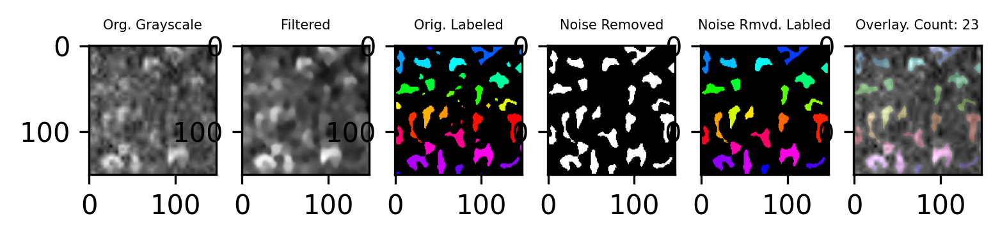

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
10.8
scales: 16
212020Ventral-NoFlash-1.png
25


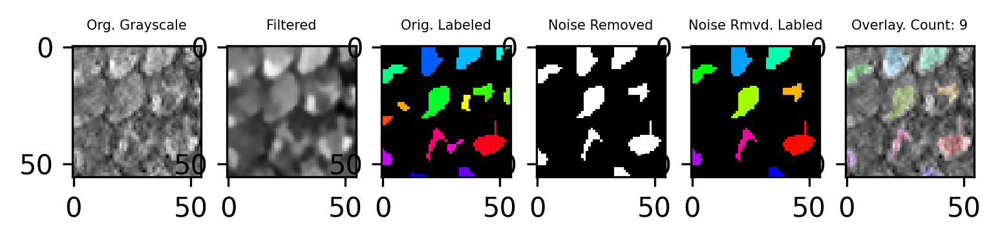

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 10
214993Ventral-Flash-2.png
25


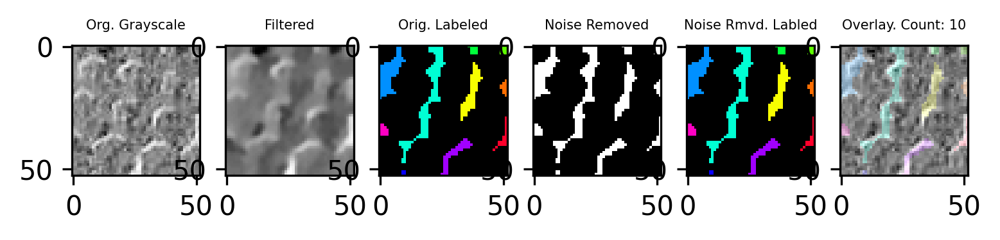

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
7.65
scales: 17
212020Ventral-NoFlash-3.png
25


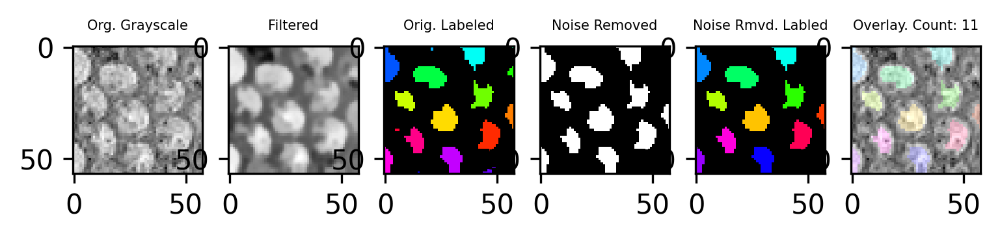

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
38.5625
scales: 36
226123Dorsal-NoFlash-4.png
25


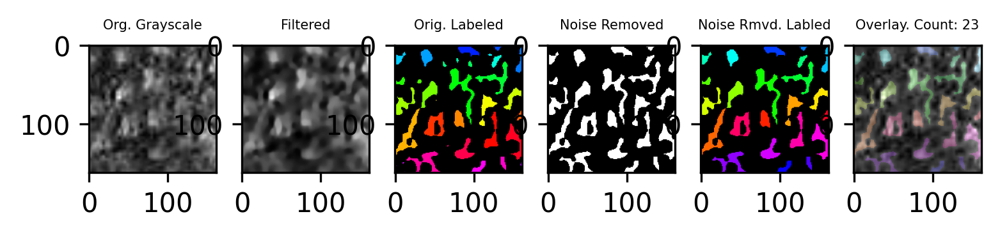

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
107.65
scales: 15
251165Dorsal-NoFlash-3.png
65


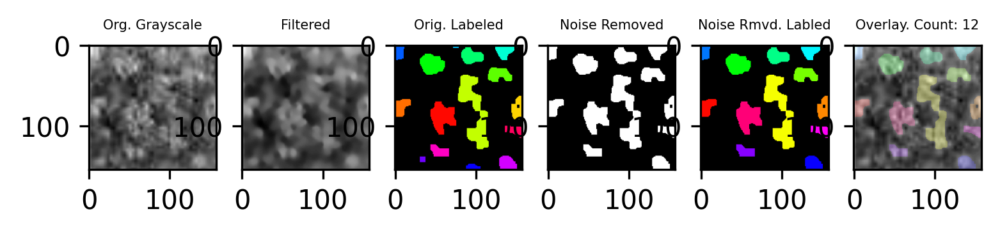

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
30.160000000000004
scales: 66
226123Dorsal-Flash-1.png
25


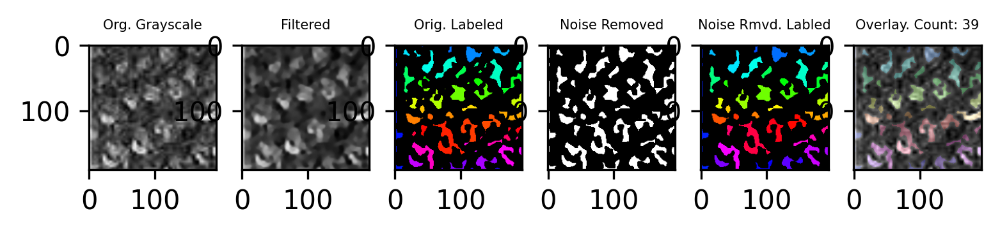

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
13.675
scales: 11
212018Ventral-NoFlash-3.png
25


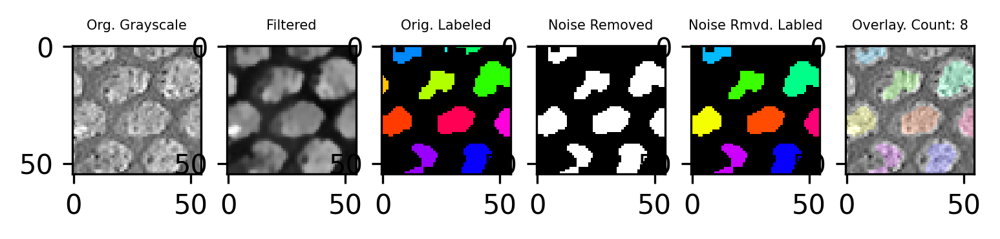

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
9.716666666666667
scales: 20
212018Ventral-NoFlash-2.png
25


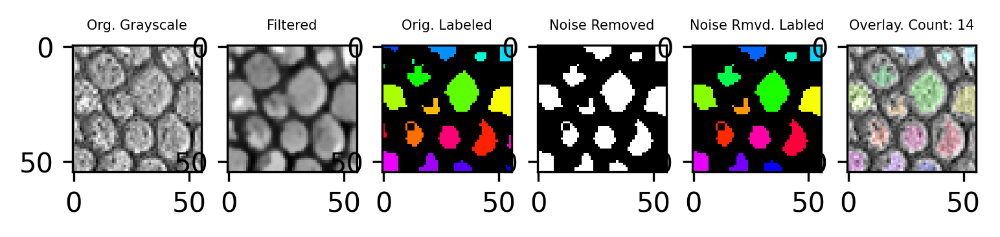

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
20.4125
scales: 45
251165Dorsal-NoFlash-2.png
25


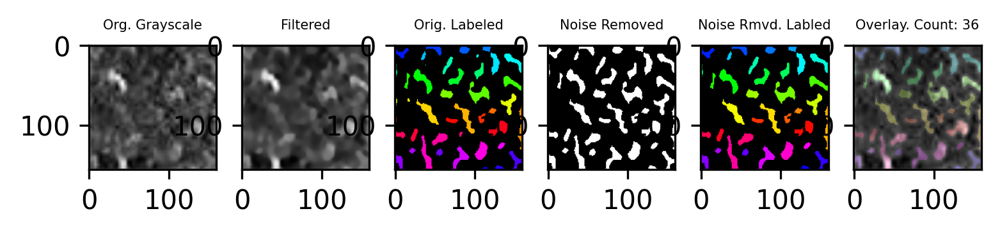

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
16.8
scales: 14
212020Ventral-NoFlash-2.png
25


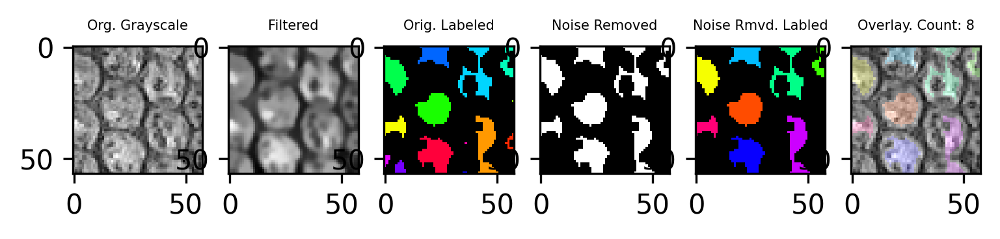

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 2
214993Ventral-Flash-1.png
45


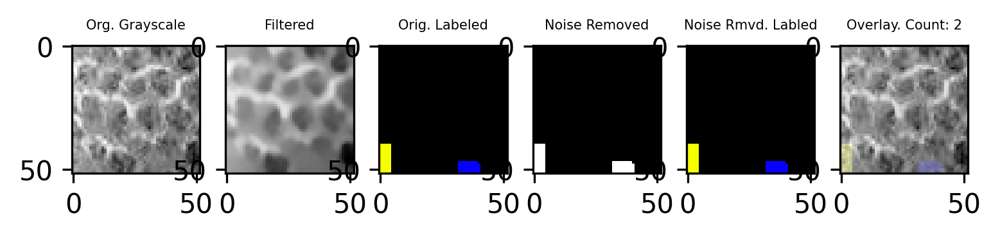

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
266.1
scales: 12
226123Ventral-Flash-3.png
65


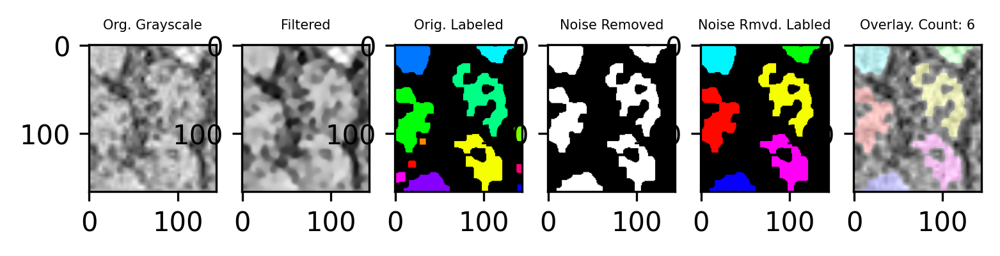

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 43
212020Dorsal-NoFlash-3.png
15


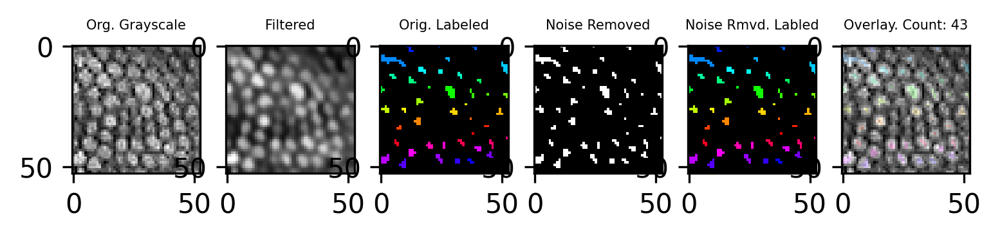

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 44
212020Dorsal-NoFlash-2.png
15


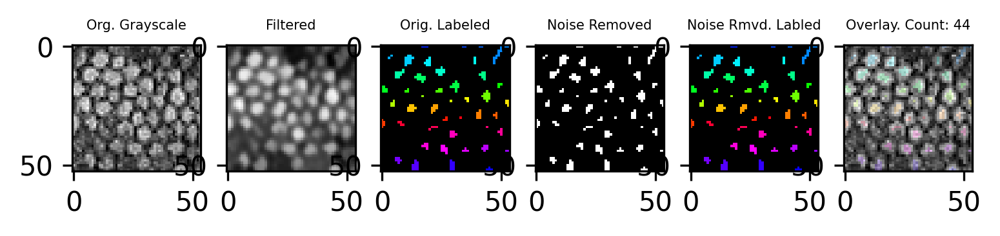

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
288.96
scales: 18
226123Ventral-Flash-2.png
65


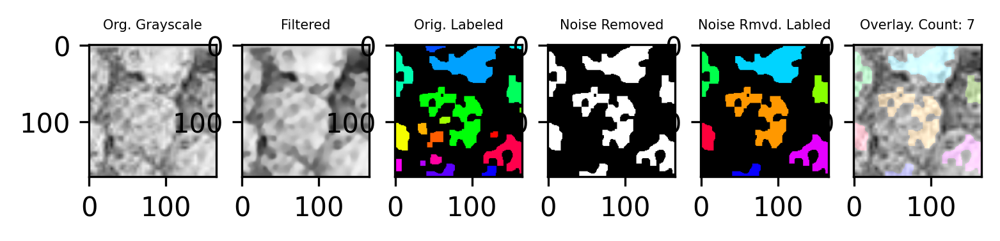

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
nan
scales: 49
212020Dorsal-NoFlash-1.png
15


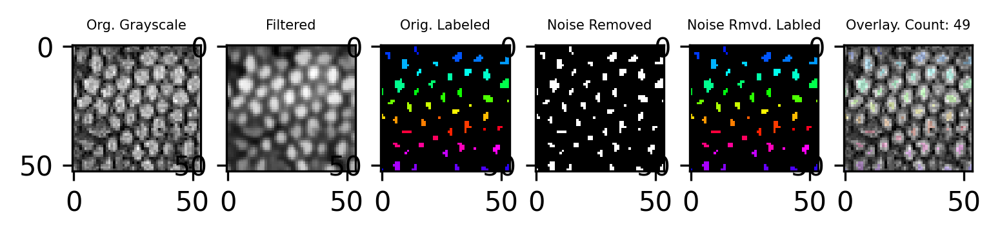

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
226.375
scales: 11
226123Ventral-Flash-1.png
65


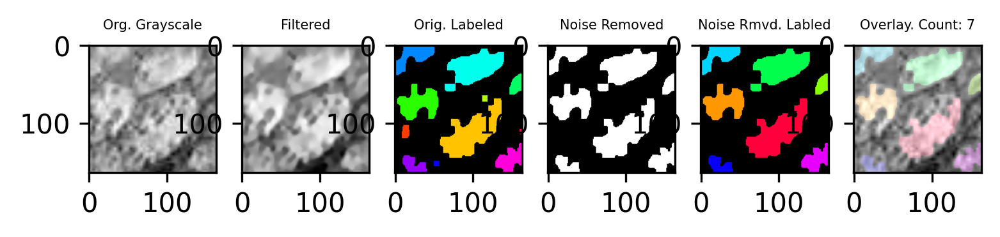

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
107.275
scales: 9
226121Ventral-NoFlash-3.png
65


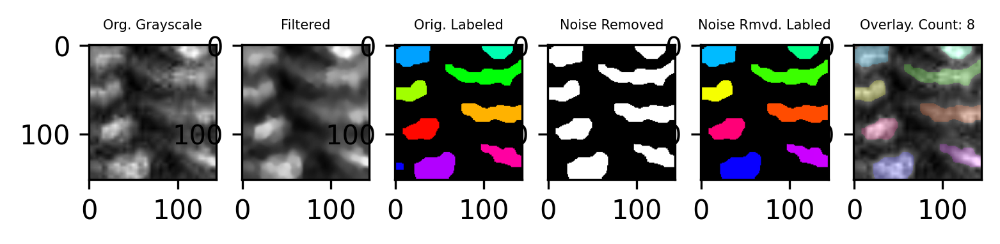

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
8.5
scales: 14
212010Ventral-NoFlash-2.png
25


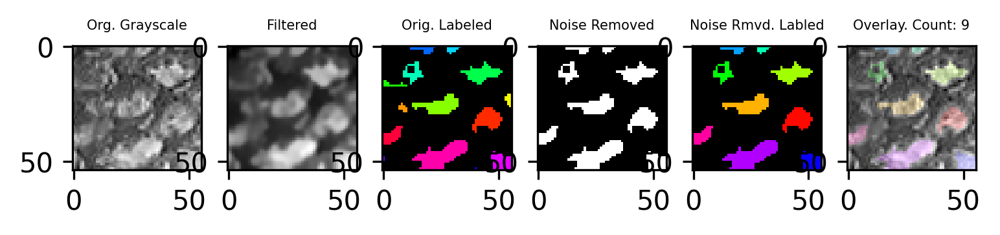

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
138.0
scales: 6
212010Ventral-NoFlash-3.png
65


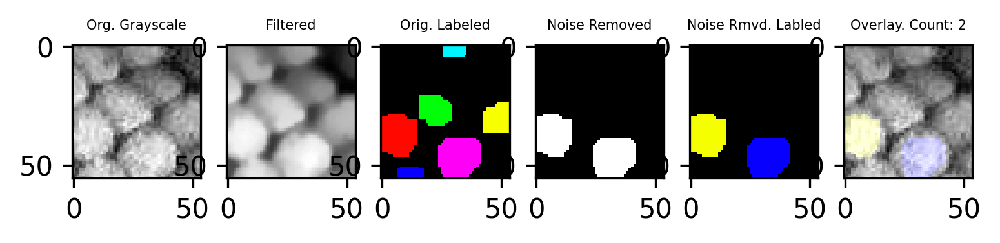

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
258.8
scales: 9
226121Ventral-NoFlash-2.png
65


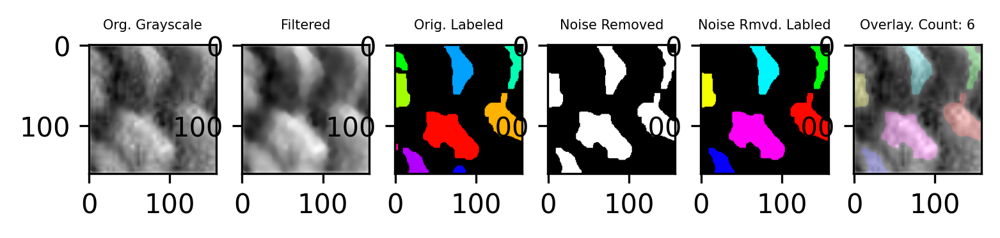

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
14.75
scales: 14
212010Ventral-NoFlash-1.png
25


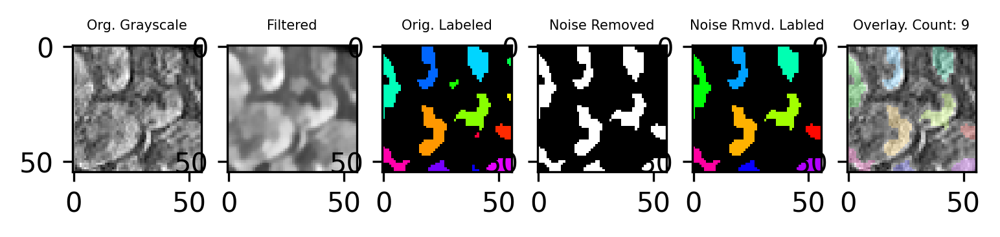

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
91.75
scales: 9
226121Ventral-NoFlash-1.png
45


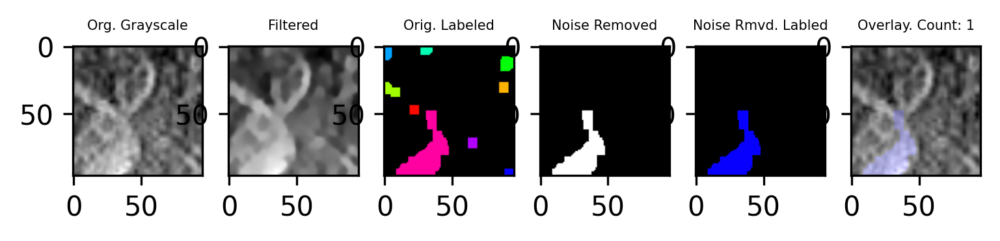

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
628.25
scales: 12
214993Ventral-NoFlash-1.png
65


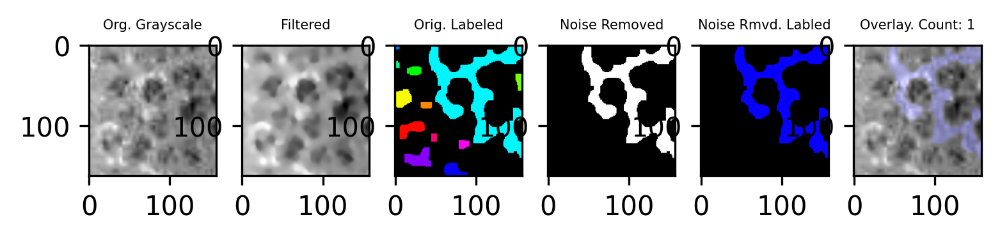

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
24.35
scales: 38
214993Ventral-NoFlash-3.png
25


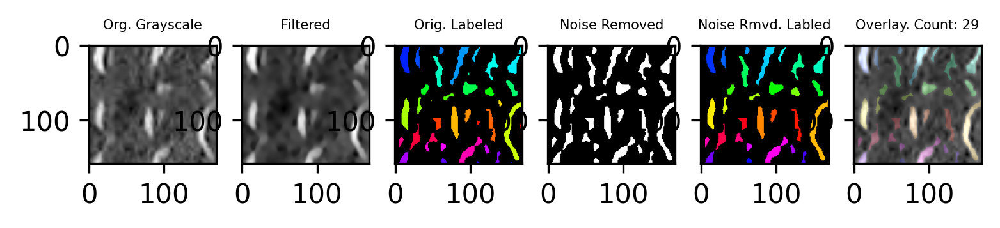

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2
370.2
scales: 15
214993Ventral-NoFlash-2.png
65


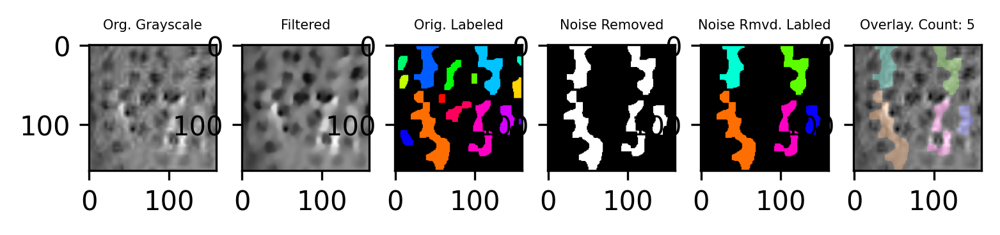

In [10]:
without_r = []
#find a way to draw the contors to see what is detected
#use a different thing????

print("TRYING TO CLEAN UP THE IMAGES AND REMOVE SMALL SPECKELS: SHOULD TAKE INTO ACCOUNT DISTANCE AND SIZE")

index = 0;
final_counts = []

print("Images", len(images))
for img in images:
    binary_map = (img > 0).astype(np.uint8)
    connectivity = 4 # or whatever you prefer
    output = cv2.connectedComponentsWithStats(binary_map, connectivity, cv2.CV_32S)
    stats = output[2]


    kernel = np.ones((3,3),np.uint8)
    #opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=1)
    #closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations = 1)

    
    #review: what exactly does this do?
    cnts = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    print(len(cnts))
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    
    print(averages[index]/10)
    
    print("scales:", len(cnts))
    
    
    for c in cnts:
        area = cv2.contourArea(c)
        if area < (averages[index]/10):
            img = cv2.drawContours(img, [c], -1, (0,0,0), -1)
    
    print(image_names[index])
    print(block_size[index][0])
    plt.subplot(1,6,1), plt.imshow(original_img[index], 'gray')
    plt.title("Org. Grayscale", fontsize=5)
    plt.subplot(1,6,2), plt.imshow(filter_img[index], 'gray')
    plt.title("Filtered", fontsize=5)
    plt.subplot(1,6,3), plt.imshow(labeled_imgs[index], 'gray')
    plt.title("Orig. Labeled", fontsize=5)
    plt.subplot(1,6,4), plt.imshow(img, 'gray')
    plt.title("Noise Removed", fontsize=5)


    # Label and count (taken from maggie's code)
    # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
    count, labels = cv2.connectedComponents(img)                
    count = count - 1 # background doesn't count as a scale
    label_hue = np.uint8(179 * labels / np.max(labels))
    blank_ch = 255 * np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
    labeled_img[label_hue == 0] = 0
    without_r.append(labeled_img)

    plt.subplot(1, 6, 5), plt.imshow(labeled_img, 'gray')
    plt.title("Noise Rmvd. Labled", fontsize=5)
    plt.subplot(1, 6, 6), plt.imshow(overlay(original_img[index], labeled_img))
    
    final_counts.append(count)
    plt.title("Overlay. Count: " + str(count), fontsize=5)
    


    plt.show()
    index = index + 1




In [71]:
# print(final_counts)

def trial(names):
    trials = []
    for name in names:
        trials.append("Trial " + str(name[-5]))
    return trials
          
print(len(final_counts), len(image_names))
short_image_names = []
for name in image_names:
    short_image_names.append(str(name[0:-6]))
    
#print(short_image_names)
trial_num = Table().with_column("Img Name", short_image_names).group("Img Name").sort("Img Name").column("count")

data = Table().with_columns("Img Name", short_image_names, "trial", trial(image_names), "Counts", final_counts)
data = data.sort("Img Name")
data = data.pivot("trial", "Img Name", "Counts", sum).with_column("# Trials", trial_num)

data = data.with_column("Averge", (data.column("Trial 1") + data.column("Trial 2") + data.column("Trial 3") + data.column("Trial 4"))/(data.column("# Trials")))

data.show()
names.show()

55 55


Img Name,Trial 1,Trial 2,Trial 3,Trial 4,# Trials,Averge
212010Ventral-NoFlash,9,9,2,0,3,6.66667
212018Dorsal-NoFlash,41,46,50,0,3,45.6667
212018Ventral-NoFlash,12,14,8,0,3,11.3333
212019Dorsal-NoFlash,23,0,22,0,3,15
212019Ventral-NoFlash,7,10,11,0,3,9.33333
212020Dorsal-NoFlash,49,44,43,0,3,45.3333
212020Ventral-NoFlash,9,8,11,0,3,9.33333
214993Dorsal-NoFlash,27,32,30,0,3,29.6667
214993Ventral-Flash,2,10,25,0,3,12.3333
214993Ventral-NoFlash,1,5,29,0,3,11.6667


Img Name,count
212010Ventral-NoFlash,3
212018Dorsal-NoFlash,3
212018Ventral-NoFlash,3
212019Dorsal-NoFlash,3
212019Ventral-NoFlash,3
212020Dorsal-NoFlash,3
212020Ventral-NoFlash,3
214993Dorsal-NoFlash,3
214993Ventral-Flash,3
214993Ventral-NoFlash,3


###### def countScales(img, calculated_block_size, orig_labeled):
    block_range = make_array(calculated_block_size- 10, calculated_block_size,calculated_block_size+ 10)
    maxRoundness = 0
    for blockSize in block_range: # blocksize must be odd number
        roundness, count, labeled_img = threshold(img, blockSize)
    if roundness > maxRoundness:
        maxRoundness = roundness
        bestCount = count
        bestSize = blockSize
        bestImage = labeled_img
    displayFinal(img, bestImage, bestCount, bestSize, orig_labeled )

In [67]:
def threshold(img, blockSize):
    #img = cv2.imread(imgName)
    # convert to grayscale
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print(blockSize)
    gray = img
    # blur and adaptive thresholding
    # source: https://docs.opencv.org/master/d7/d4d/tutorial_py_thresholding.html
    blur = cv2.GaussianBlur(gray,(5,5),0)
    thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, blockSize, -2)
    # Remove noise by opening
    kernel = np.ones((3,3),np.uint8)
    if blockSize > 25:
        opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN,kernel, iterations=2)
    if blockSize <= 25:
        opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN,kernel, iterations=1)

    # Check if opening was too much
    numWhitePixels = cv2.countNonZero(opening) # number of foreground pixels
    totalPixels = img.size / 3 # not sure why it has to be divided by 3
    if numWhitePixels / totalPixels < 0.3:
    # if opening resulted in less than 30% foreground, decrease number of␣opening iterations
        opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN,kernel, iterations=1)
    # Finding sure foreground area
    dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
    ret, sure_fg = cv2.threshold(dist_transform, 1.5, 255, 0)
    sure_fg = np.uint8(sure_fg)
    # Label and count
    # source: https://medium.com/analytics-vidhya/images-processing-segmentation-and-objects-counting-in-an-image-with-python-and-opencv-216cd38aca8e
    output = cv2.connectedComponentsWithStats(sure_fg, 8, cv2.CV_32S)
    labels = output[1]
    count = output[0] - 1 # background doesn't count as a scale
    label_hue = np.uint8(179 * labels / np.max(labels))
    blank_ch = 255 * np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
    labeled_img[label_hue == 0] = 0
    stats = output[2]
    areas = []
    ratios = []
    for i in range(1, count + 1): # start at 1 instead of 0 because don't want␣to count background as a scale
        scaleArea = stats[i, cv2.CC_STAT_AREA]
        areas.append(scaleArea)
        boxArea = stats[i, cv2.CC_STAT_WIDTH] * stats[i, cv2.CC_STAT_HEIGHT]
        ratios.append(scaleArea / boxArea)
    avgRoundness = sum(ratios) / len(ratios)
    #avgSize = sum(areas) / len(areas)
    #variance = sum([((x - avgSize) ** 2) for x in areas]) / len(areas)
    #stdDev = variance ** 0.5
    #displayTests(gray, imgName, thresh, opening, sure_fg, labeled_img, count)
    return (avgRoundness, count, labeled_img)




In [68]:
def displayFinal(img, labeled_img, count, blockSize, orig_labeled ):
    gray = img
    plt.title("Original")
    plt.subplot(1, 3, 1), plt.imshow(gray, 'gray')
    plt.subplot(1, 3, 3), plt.imshow(orig_labeled)
    plt.title("Original Labeled")
    plt.subplot(1, 3, 2), plt.imshow(labeled_img, 'gray')
    plt.title("With Roundness")
    #plt.title('Count: ' + str(count) + ', Blocksize:' + str(blockSize))
    plt.show()

15
25
35


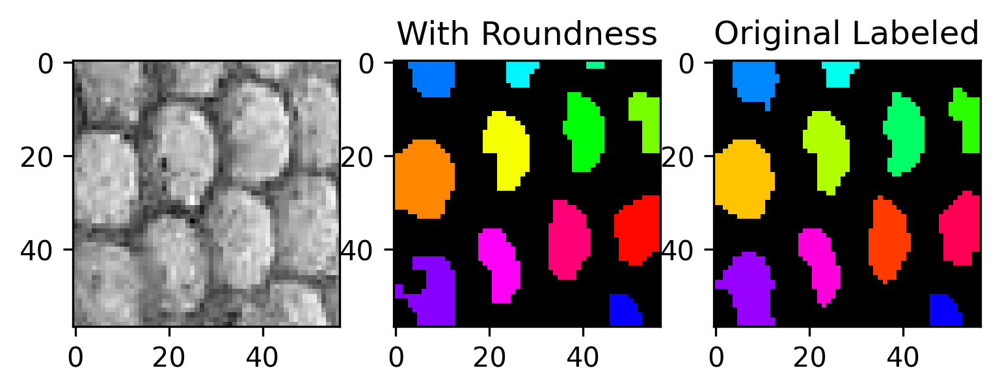

15
25
35


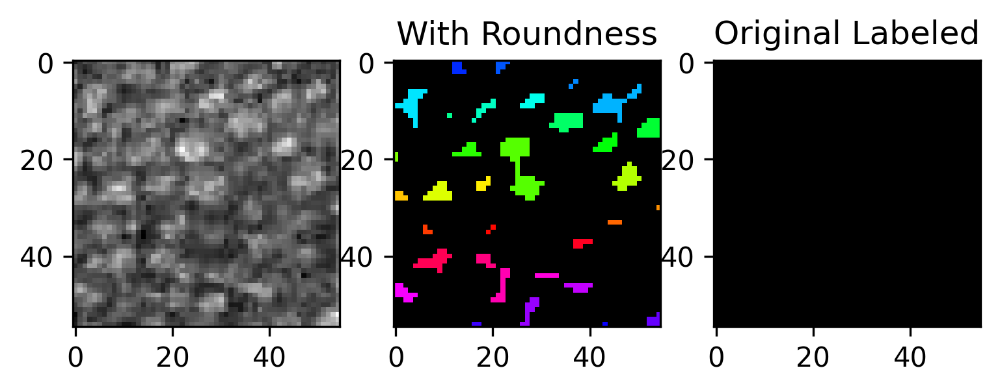

55
65
75


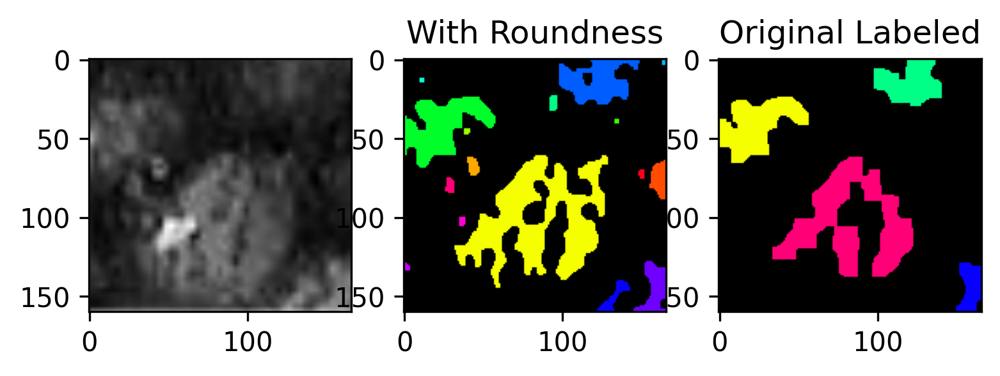

55
65
75


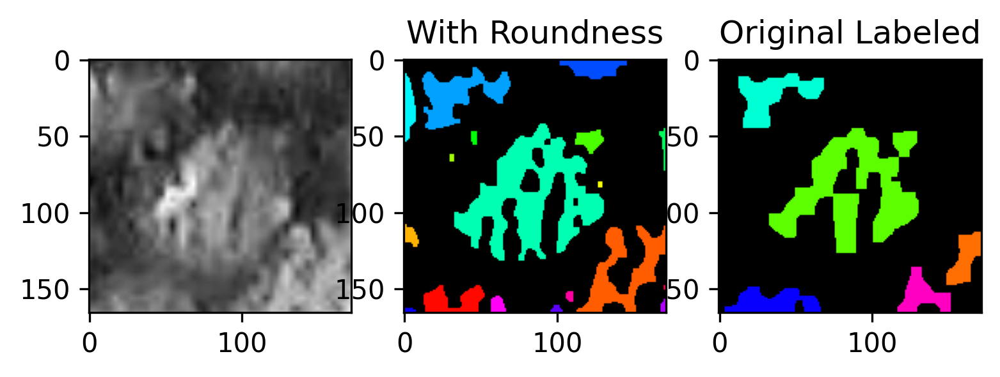

5
15
25


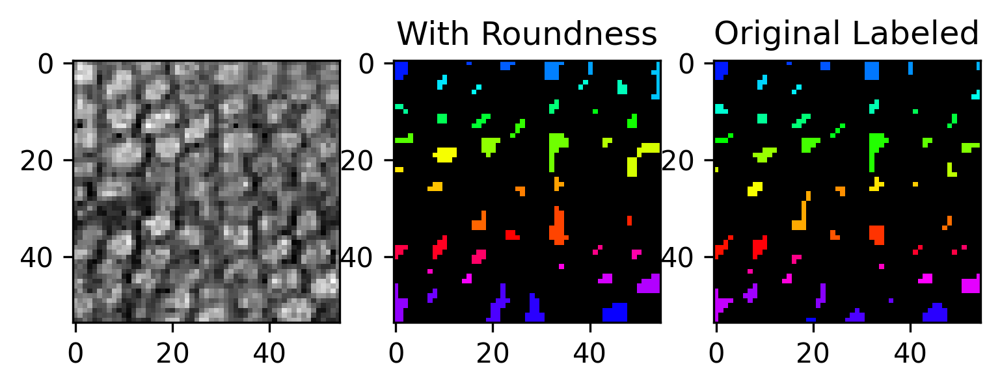

5
15
25


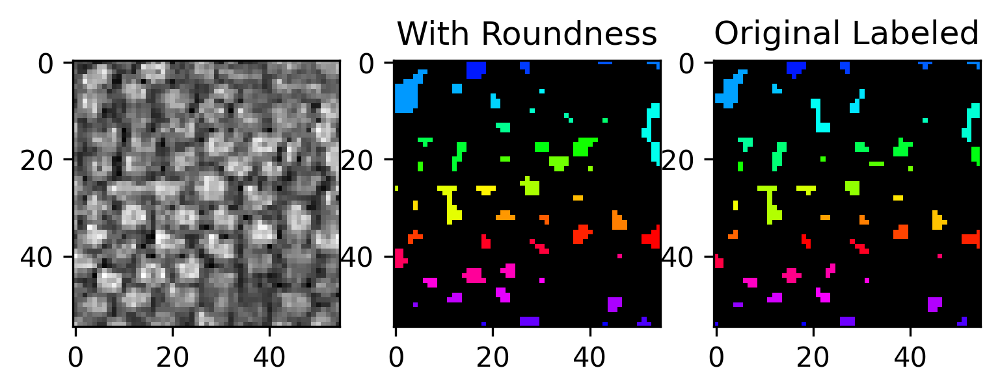

15
25
35


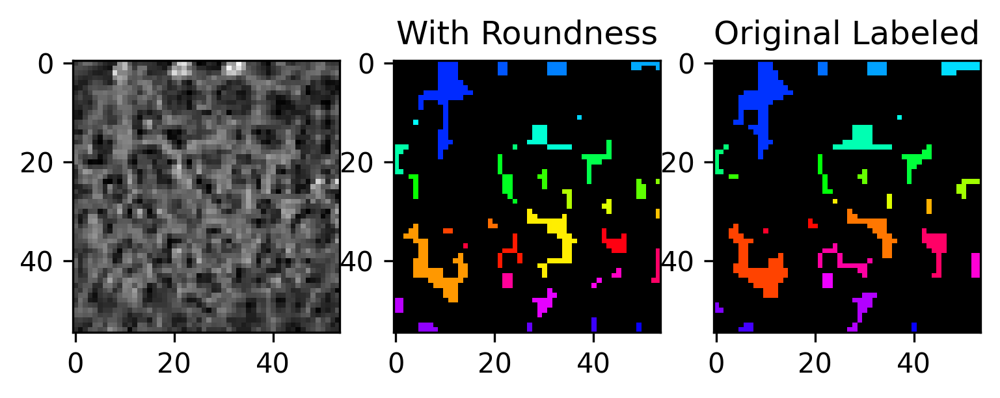

55
65
75


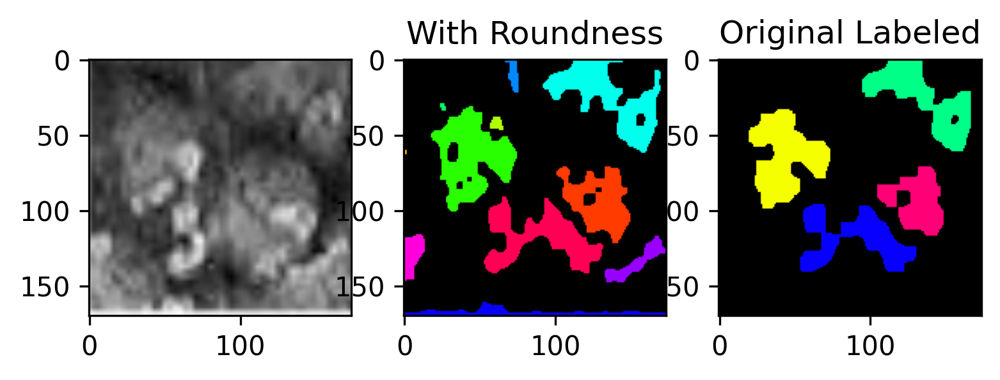

55
65
75


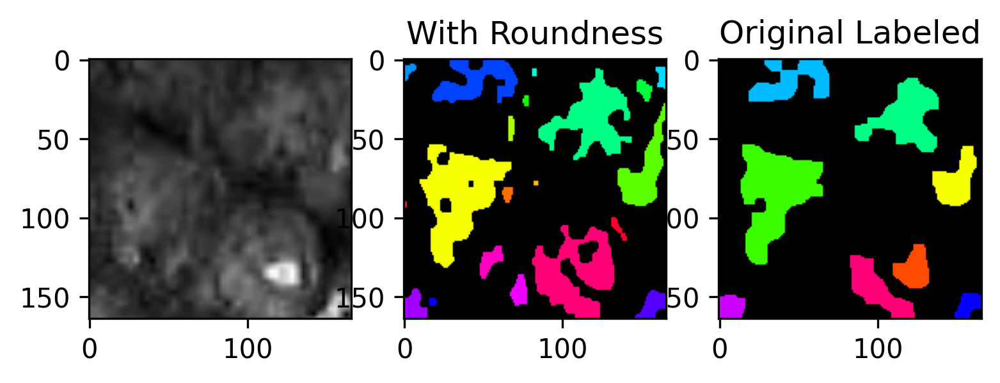

15
25
35


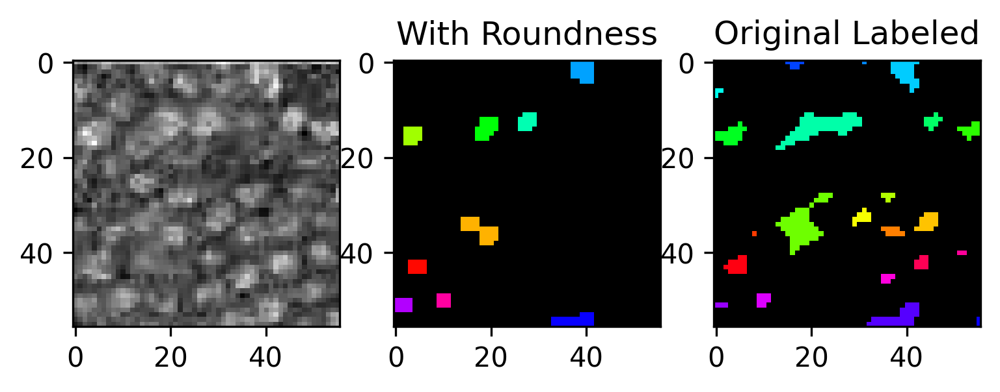

15
25
35


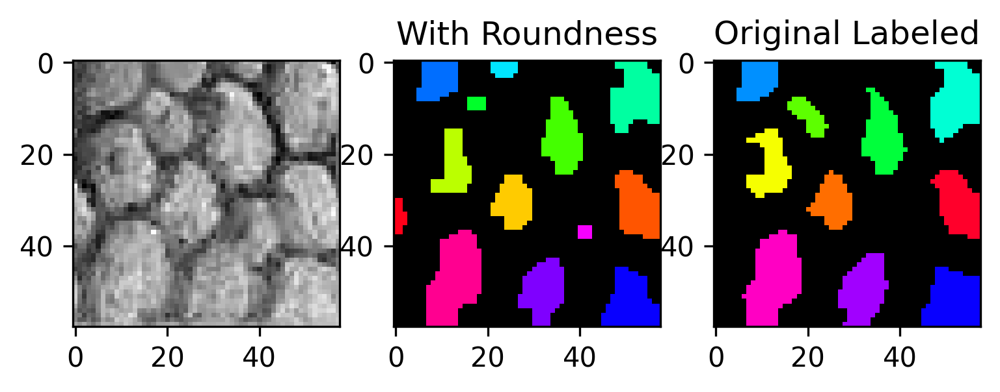

15
25
35


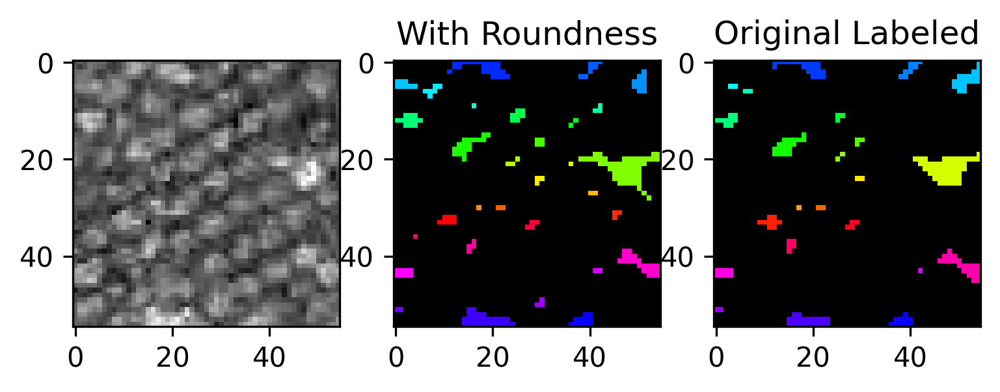

55
65
75


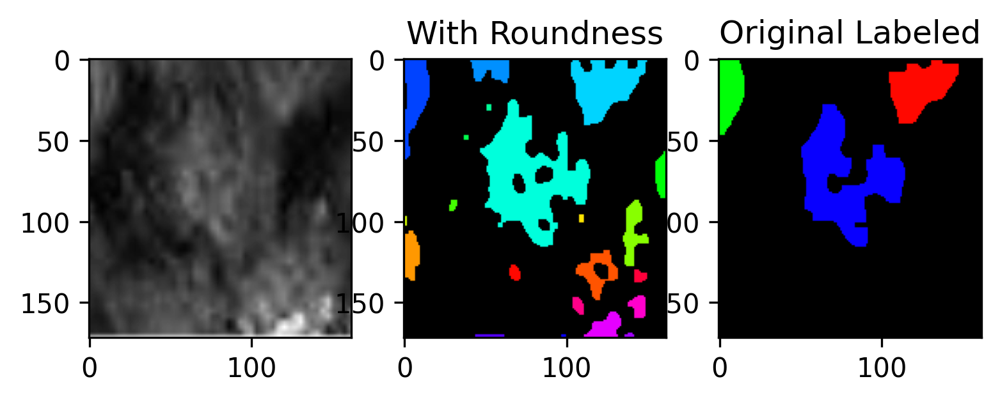

15
25
35


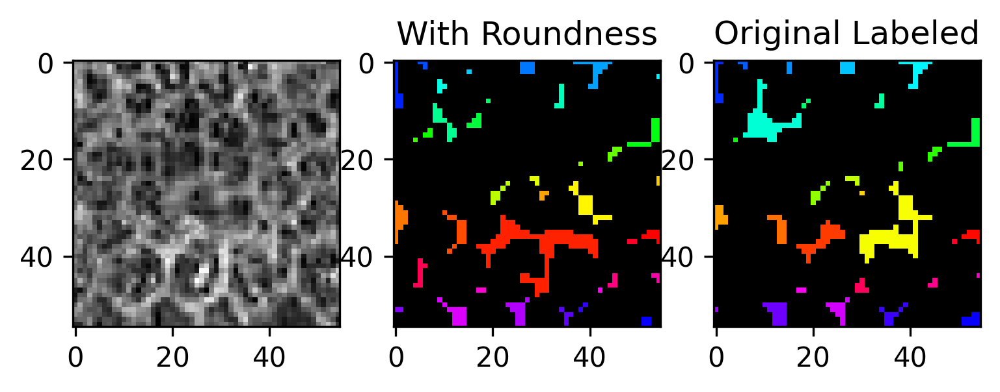

15
25
35


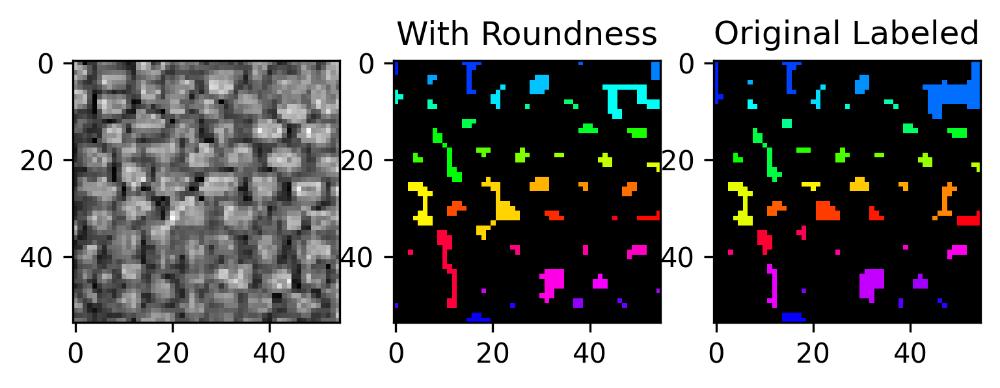

15
25
35


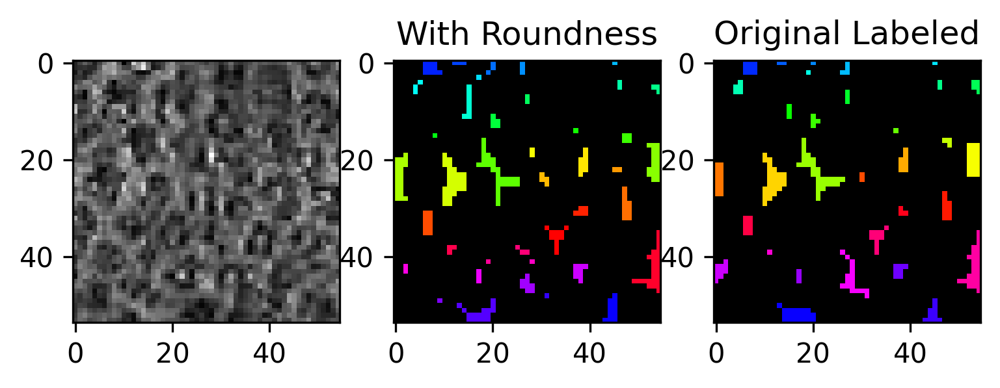

55
65
75


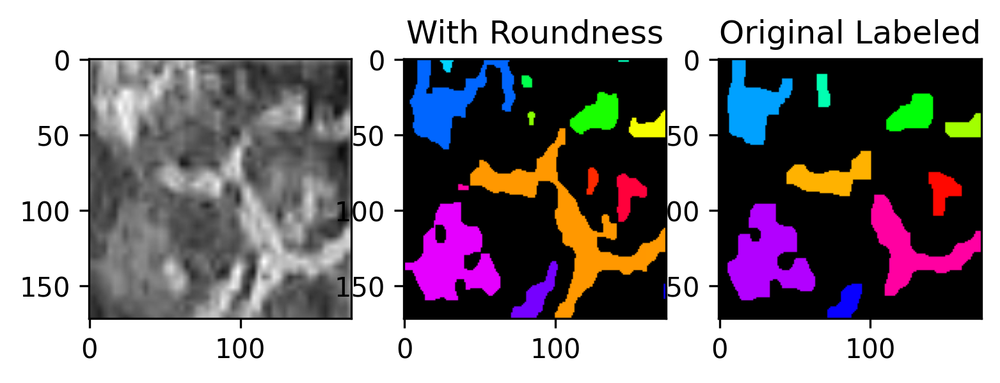

15
25
35


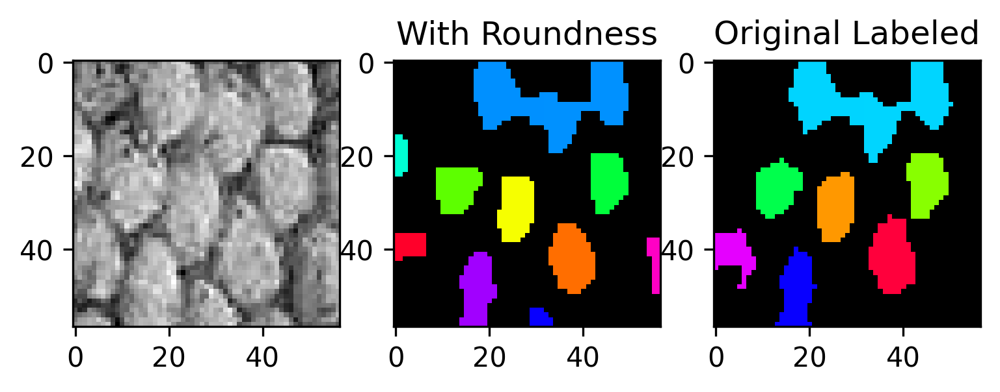

15
25
35


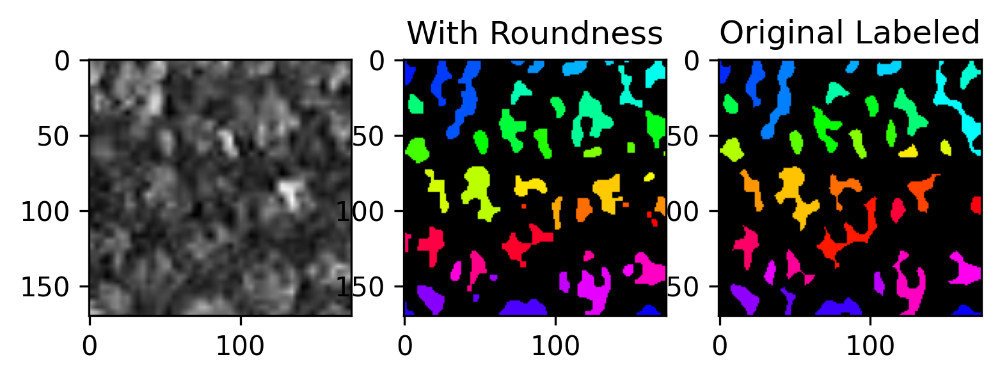

35
45
55


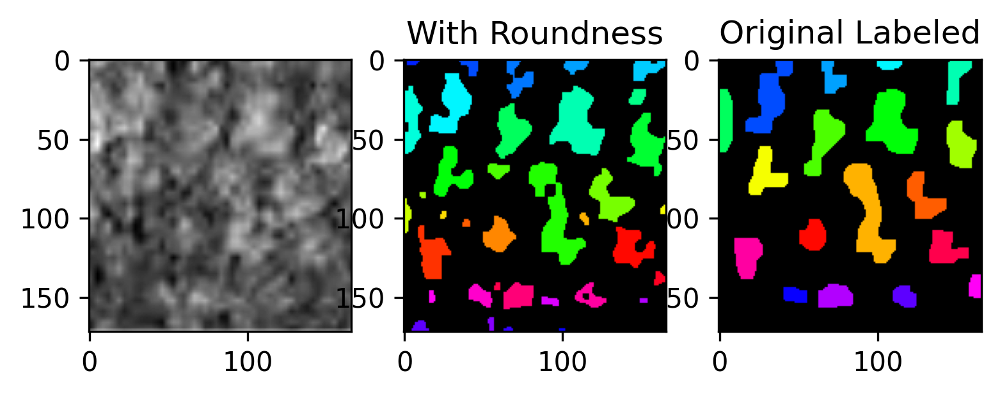

15
25
35


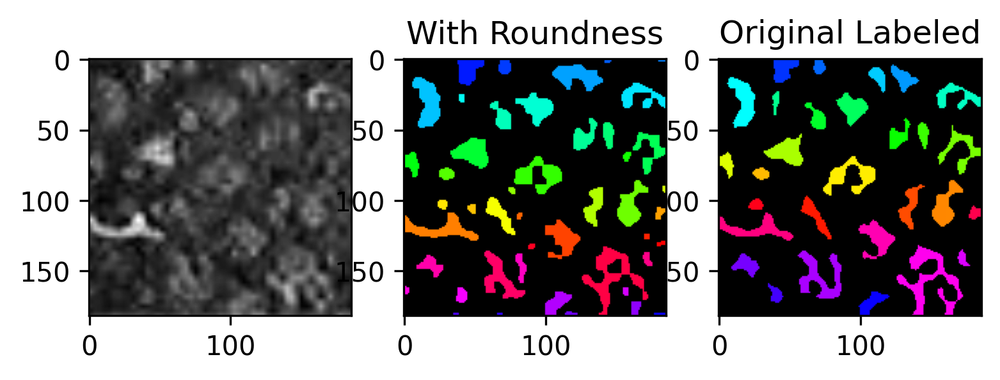

15
25
35


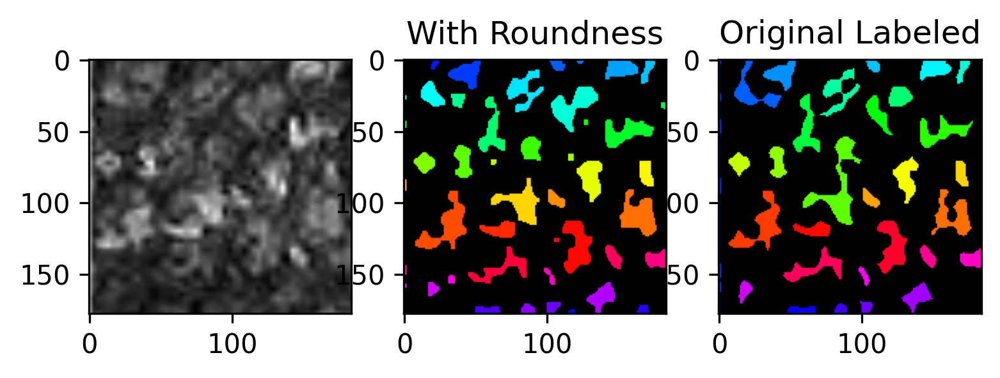

15
25
35


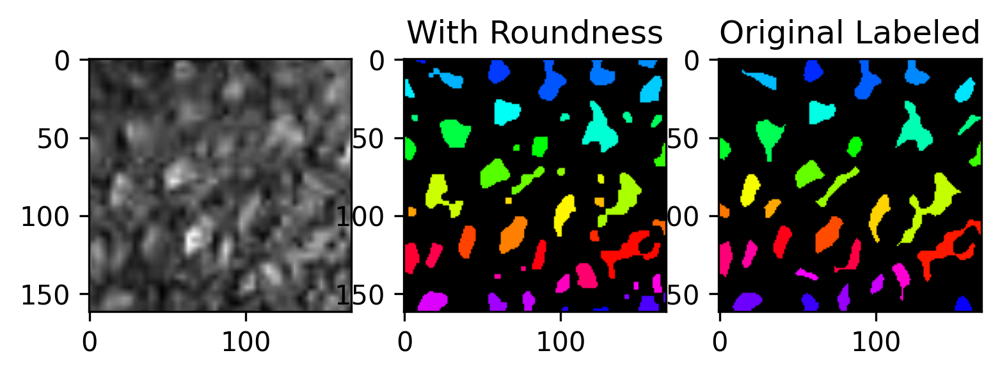

15
25
35


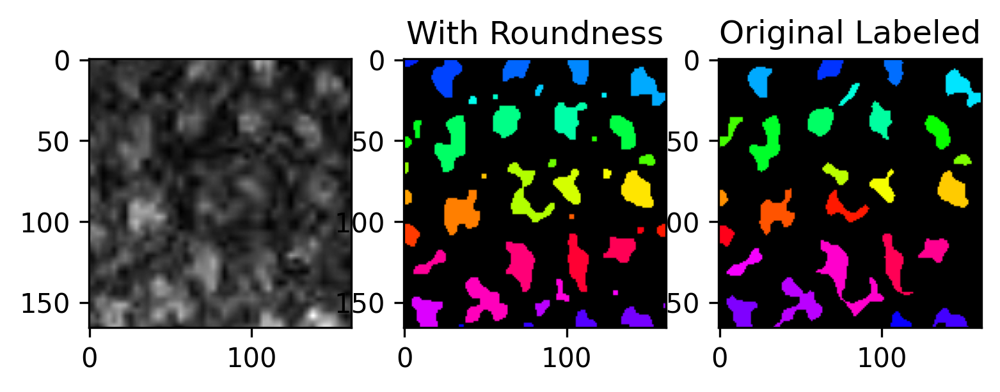

5
15
25


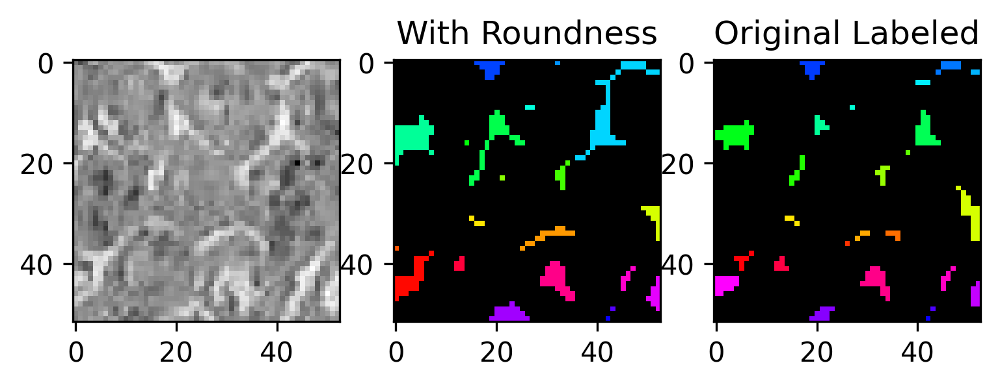

15
25
35


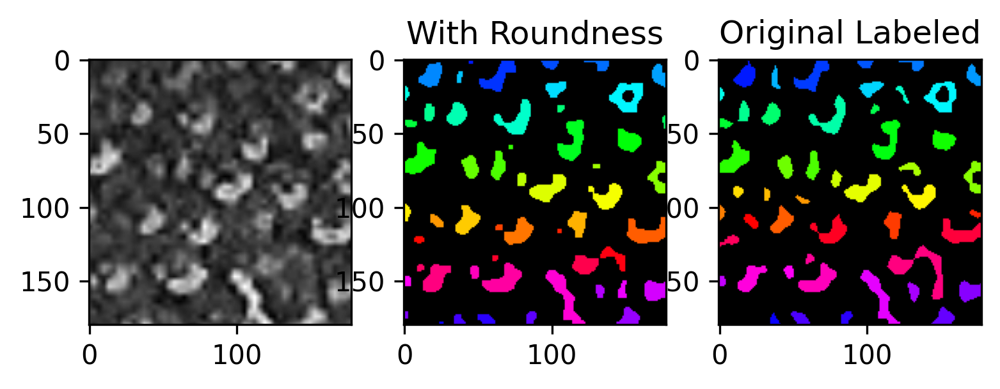

15
25
35


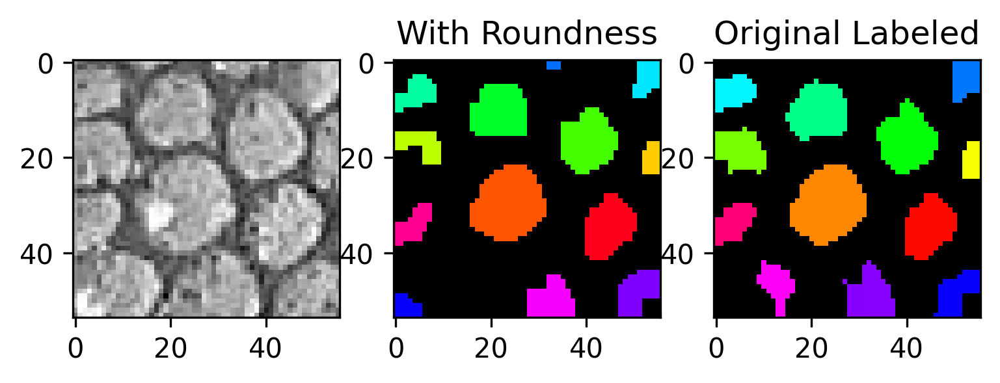

15
25
35


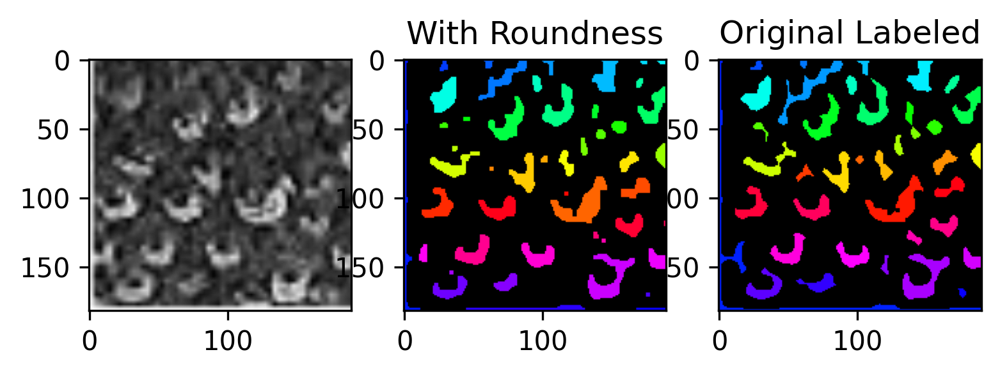

15
25
35


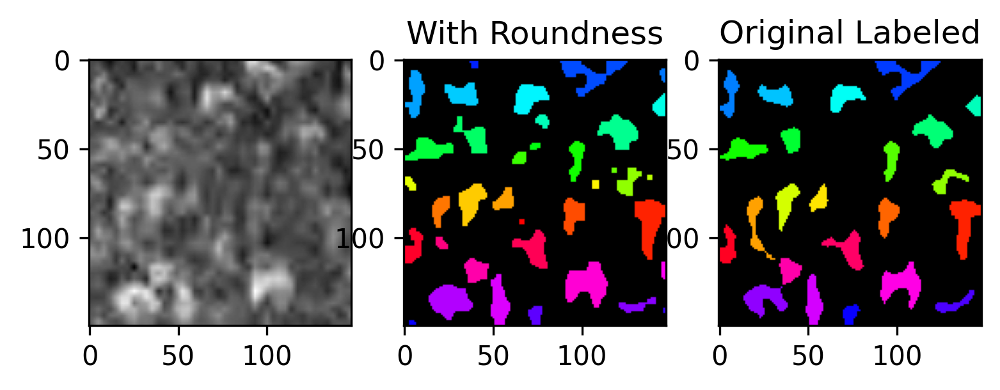

15
25
35


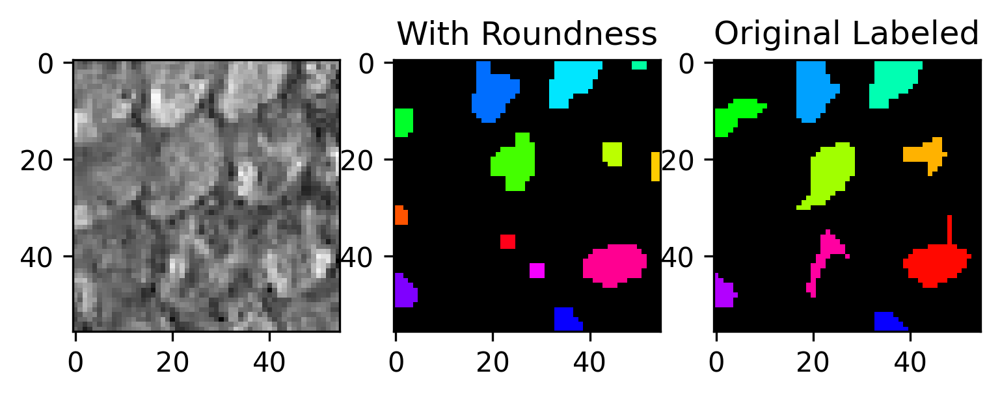

15
25
35


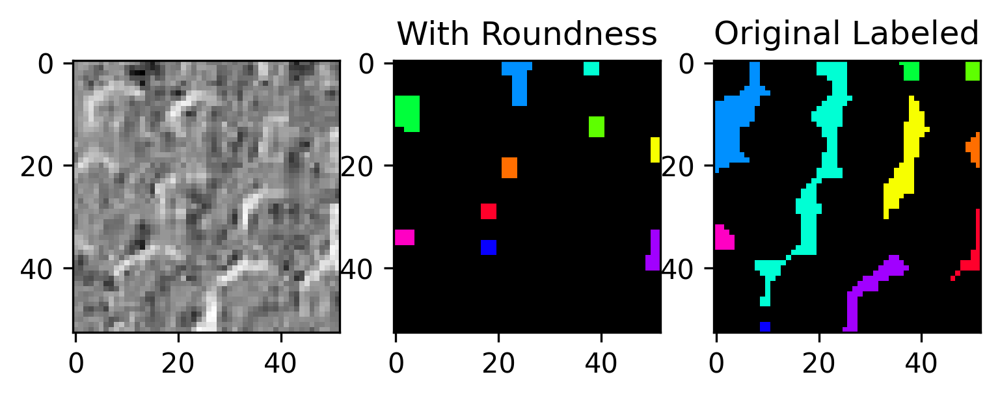

15
25
35


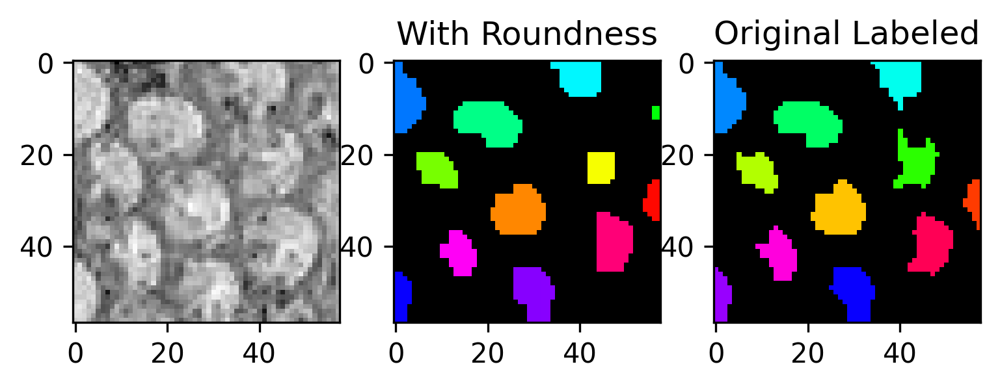

15
25
35


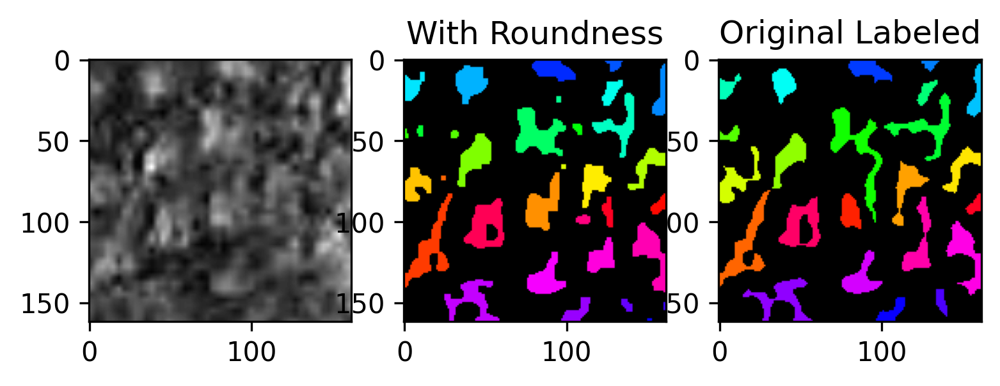

55
65
75


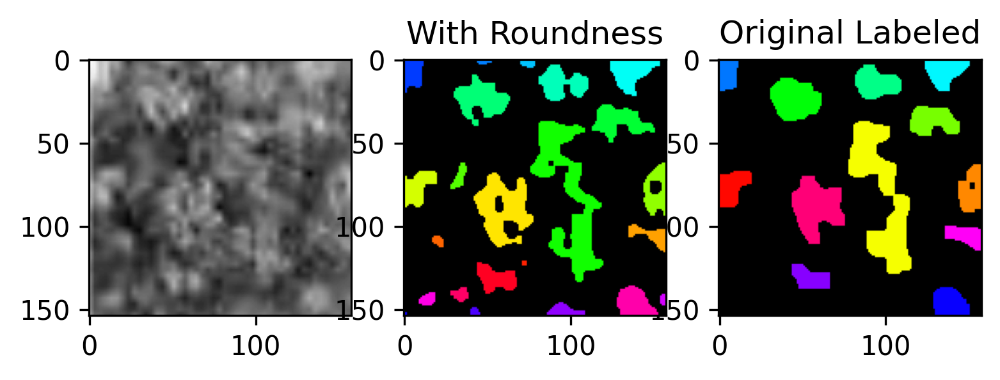

15
25
35


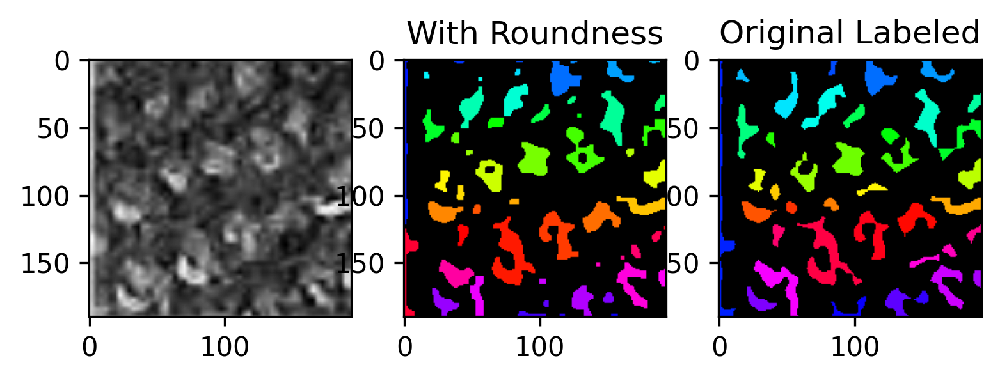

15
25
35


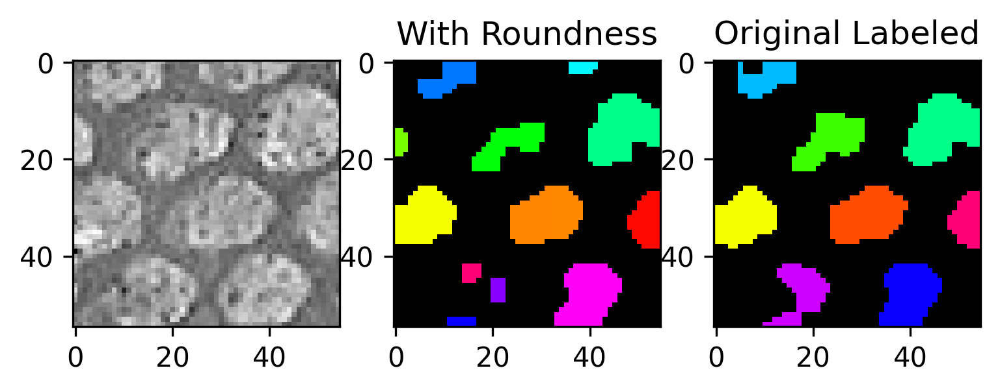

15
25
35


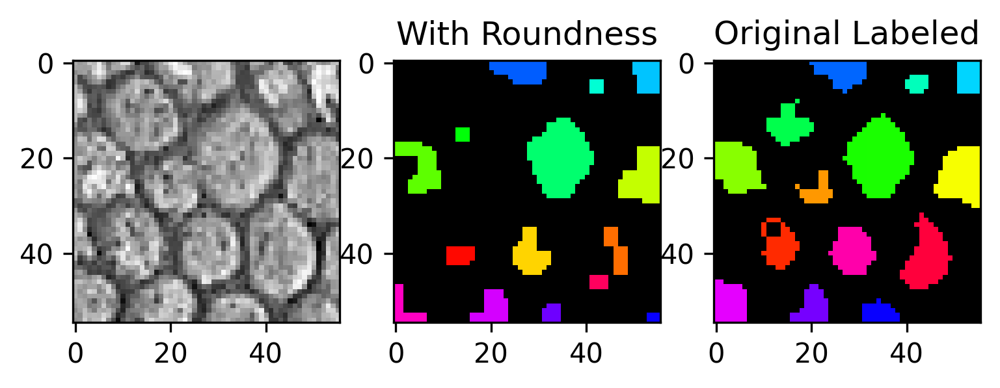

15
25
35


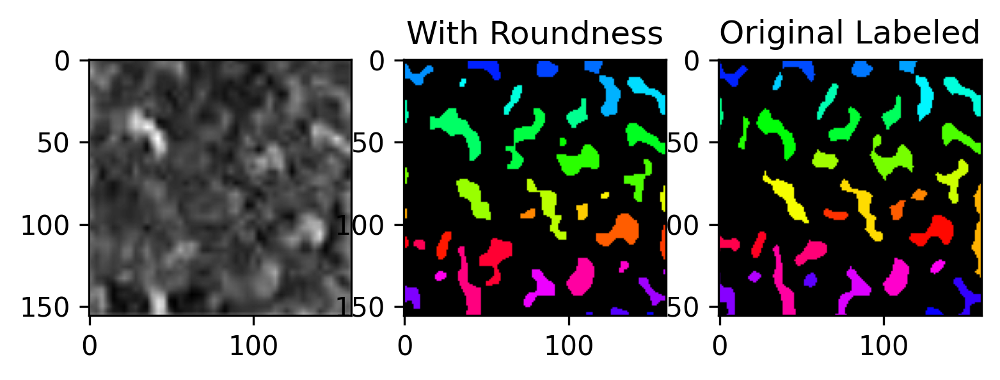

15
25
35


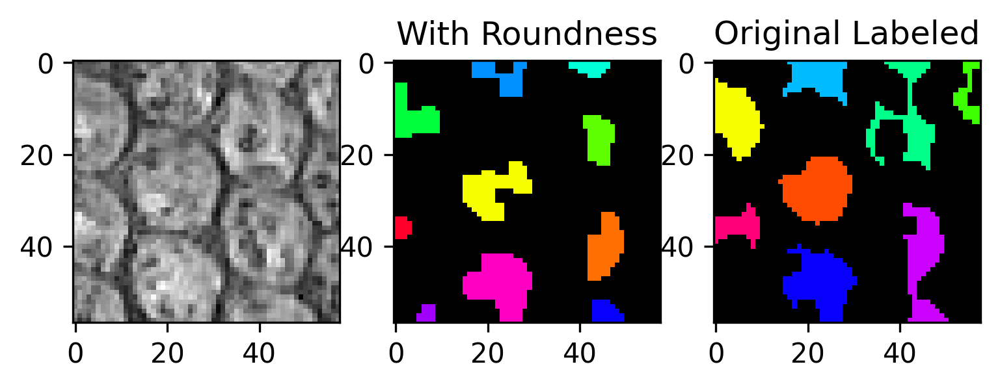

35
45
55


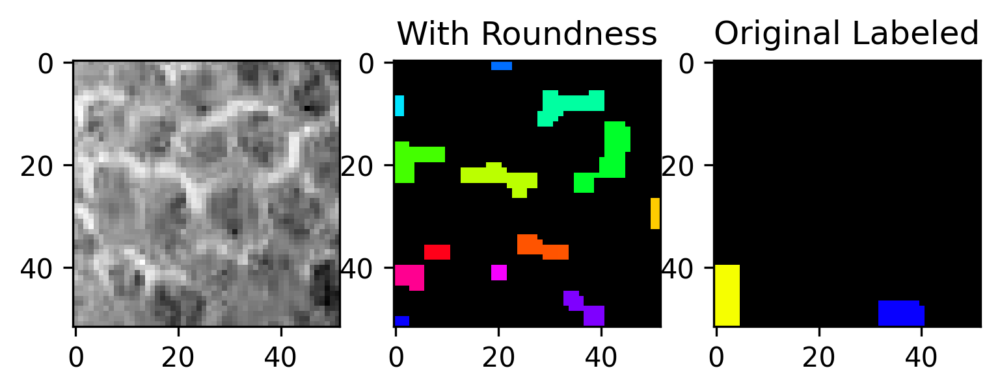

55
65
75


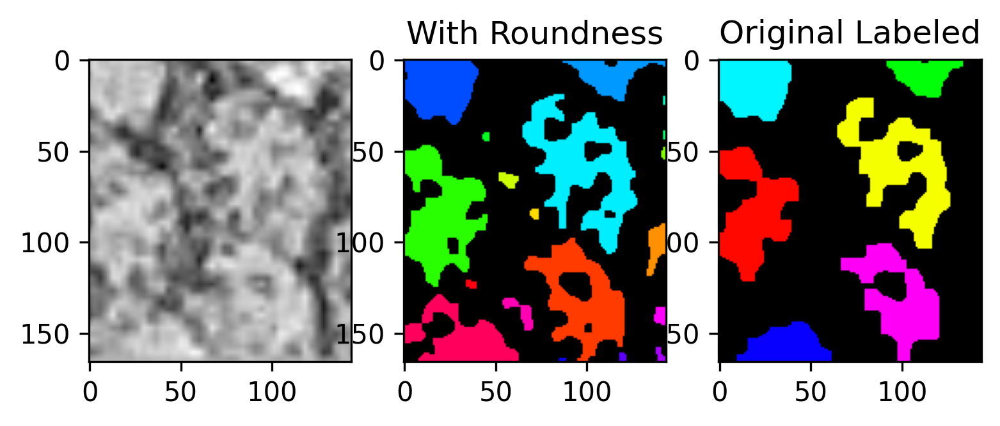

5
15
25


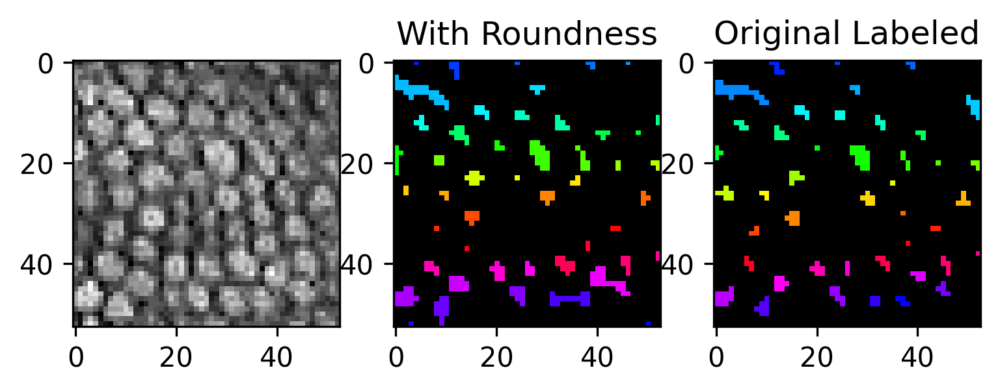

5
15
25


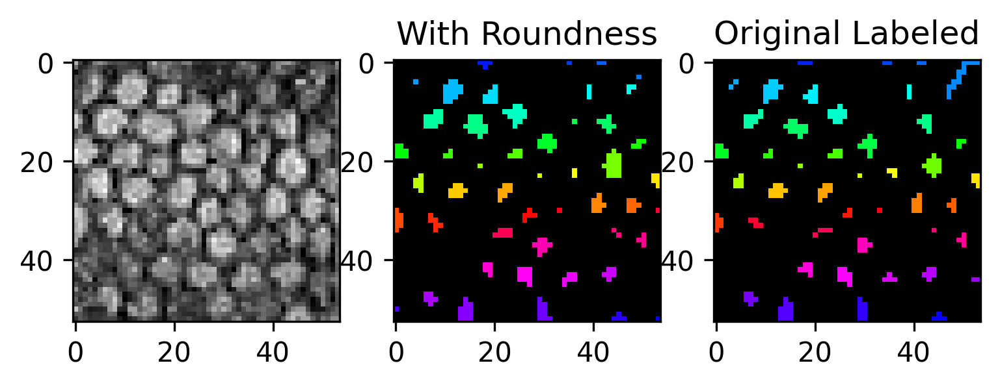

55
65
75


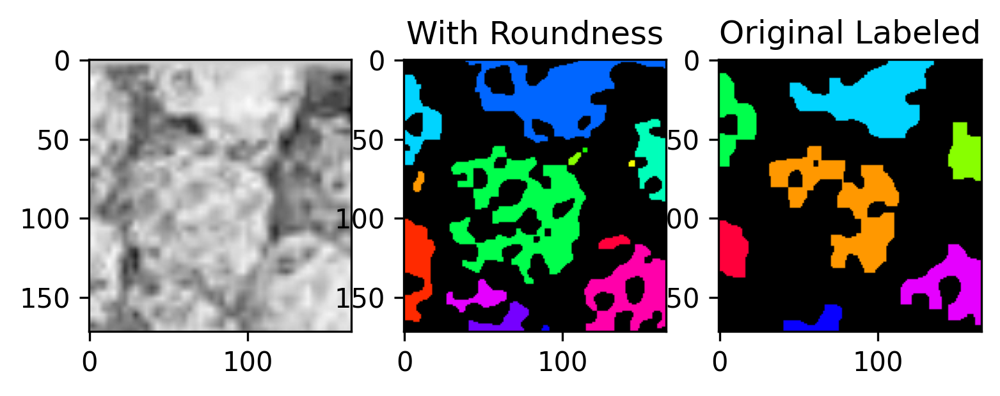

5
15
25


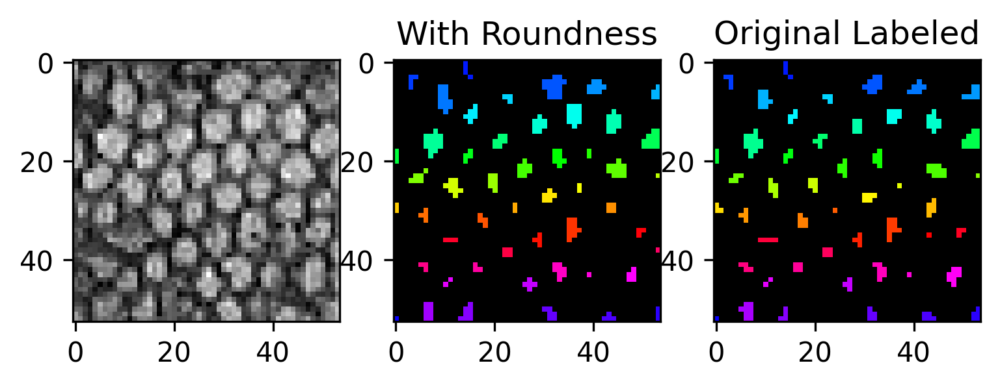

55
65
75


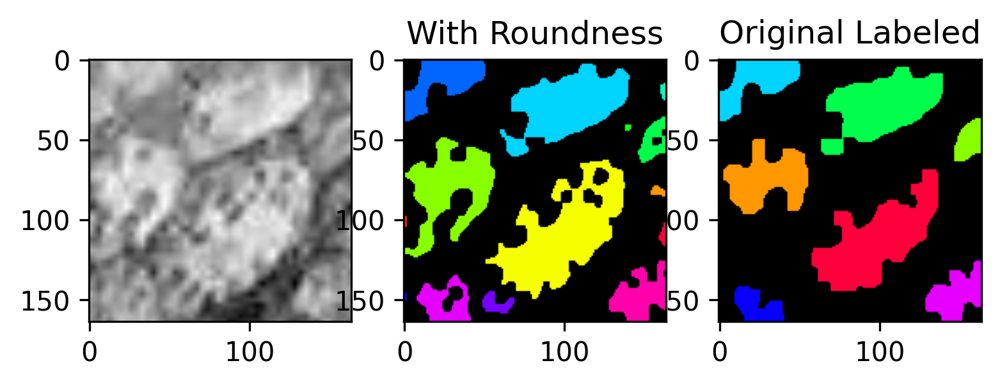

55
65
75


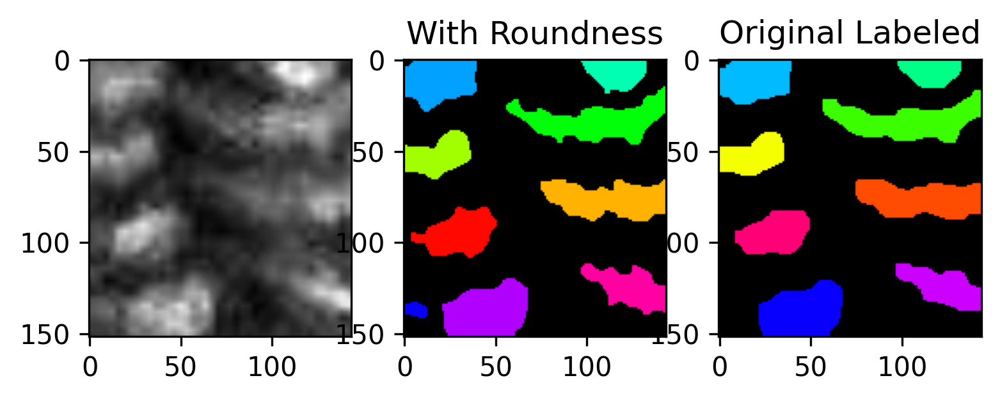

15
25
35


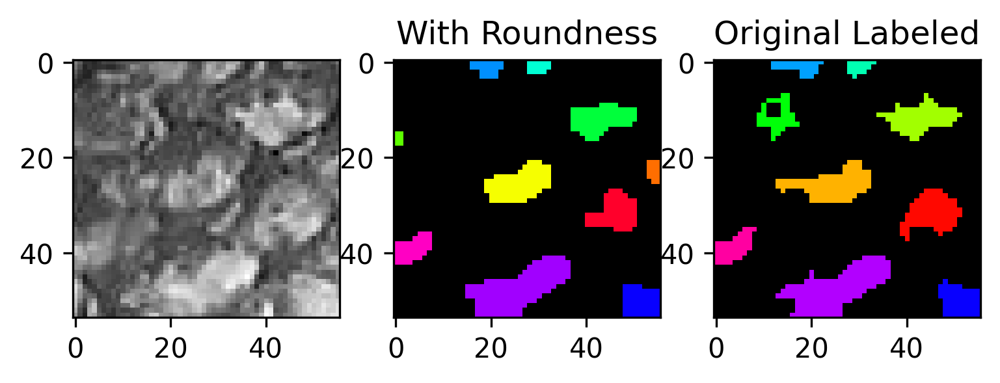

55
65
75


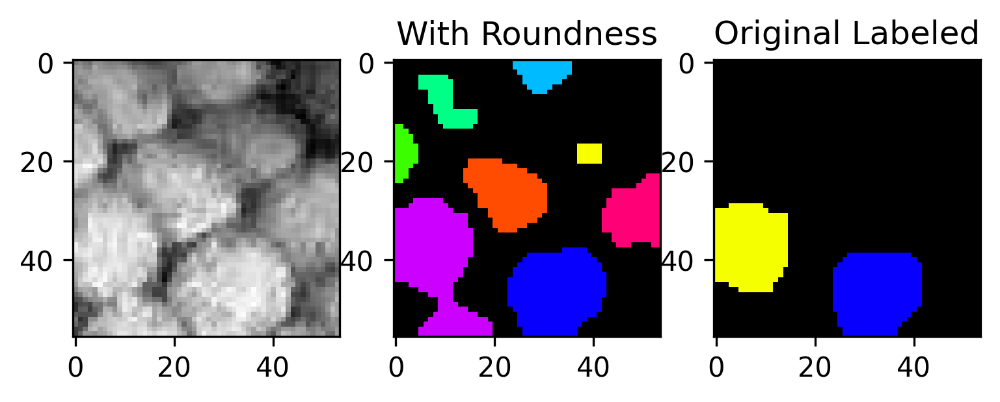

55
65
75


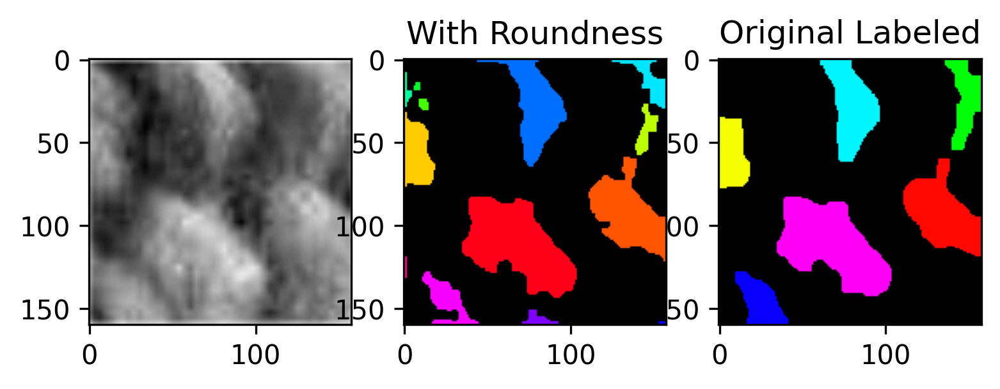

15
25
35


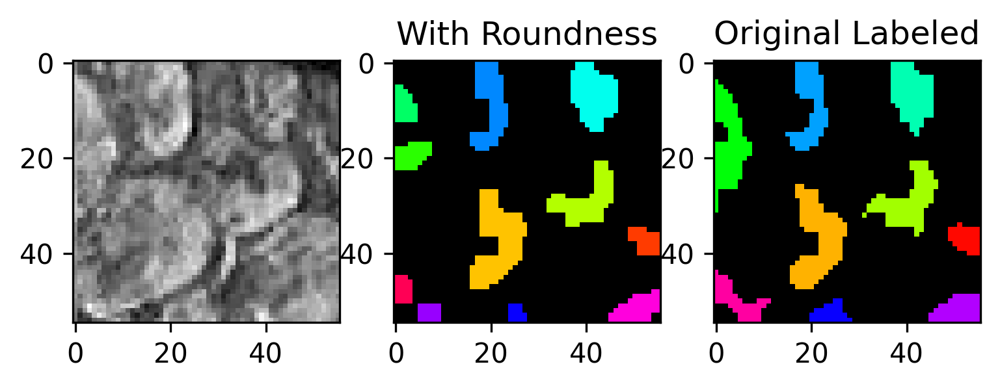

35
45
55


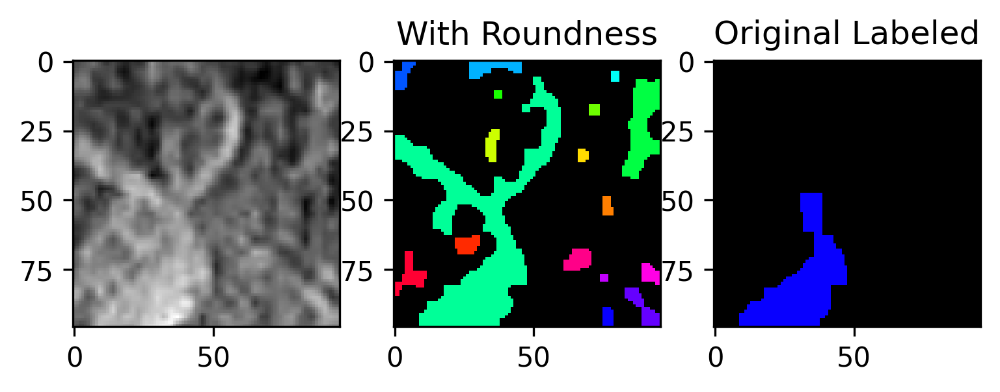

55
65
75


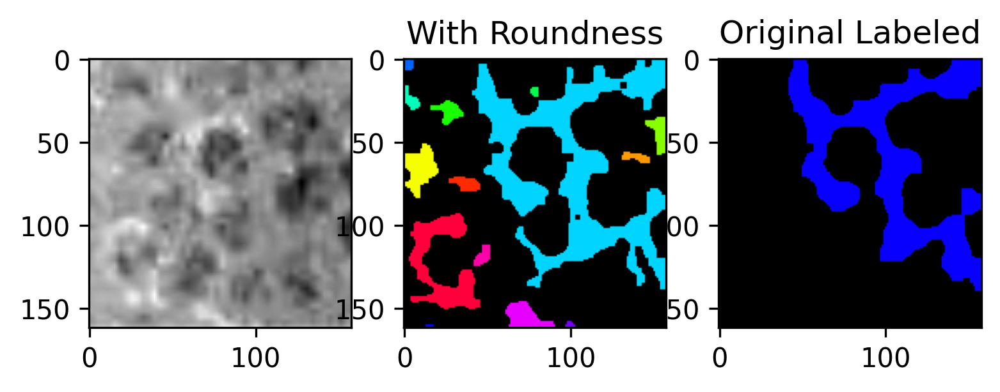

15
25
35


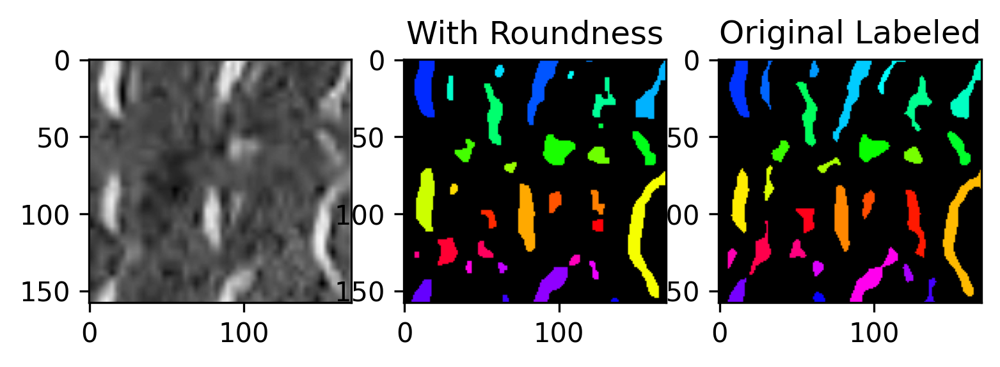

55
65
75


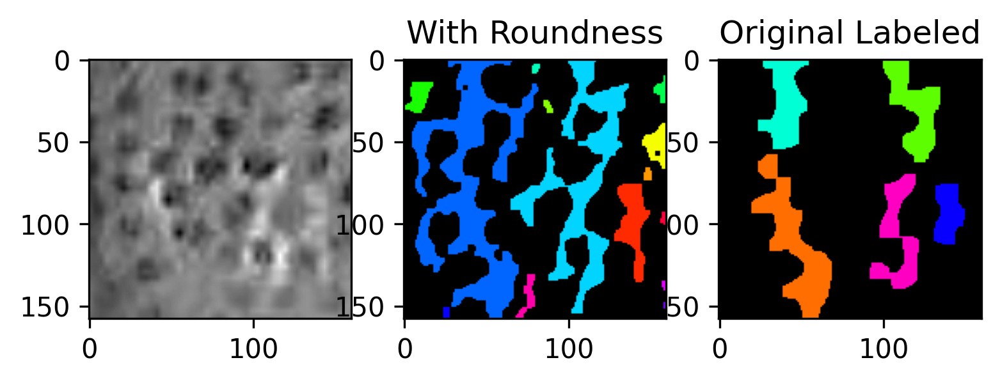

IndexError: list index out of range

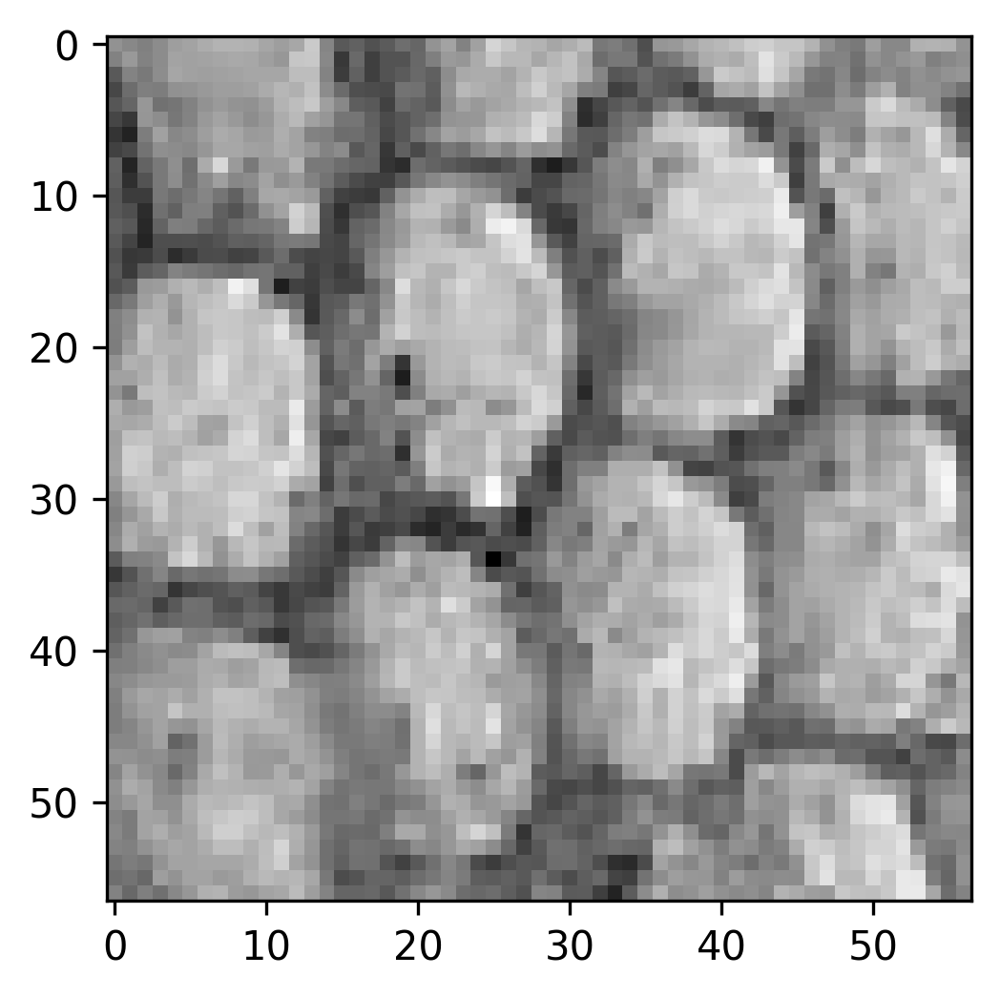

In [69]:
index = 0
for img in original_img:
    plt.imshow(img, "gray")
    countScales(img, block_size[index][0], without_r[index])
    index +=1